<a href="https://colab.research.google.com/github/tombackert/paper/blob/main/explanation_selectivity_gradcam_and_lime.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install torch torchvision torcheval matplotlib captum scikit-learn scikit-image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 19.2 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinu

In [2]:
from typing import List, Literal, Iterable, Callable

import torchvision as tv
from torchvision import models
from torchvision.tv_tensors import Image, TVTensor
import torchvision.transforms.v2.functional as transforms
from torch.masked import masked_tensor
import torcheval.metrics
import torch
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.colors import LinearSegmentedColormap ## for attribution visualization

from skimage.segmentation import felzenszwalb ## for LIME segmentation

import captum.attr
from captum.attr import LRP, Lime, LayerGradCam
from captum._utils.models.linear_model import SkLearnLinearModel
from captum.attr import visualization as viz

In [3]:
## DEFINE model and data preprocessing

def my_model_from(model: torch.nn.Module):
    """Create wrapper around model."""
    def my_model(img: Image) -> List[float]:
        """Black-box wrapper of the model: redefine according to whatever model you are using.
        Just takes an image and returns a list of scores, one per class index in categories from above.
        """
        prediction = model(img) \
            .squeeze(0) \
            .softmax(0)
        return [t.item() for t in prediction]
    return my_model

def get_predicted_class_id(prediction: List[float]) -> int:
    """Get the ID of the predicted class from a list of per-class predicted probabilities or logits."""
    return int(np.argmax(prediction))


In [4]:
## DEFINE the explainer (here: e.g., LRP)

NUM_POSTERS = 40

def posterize(img: torch.Tensor, steps: int = NUM_POSTERS, method: Literal["min", "mean", "max", "maxabs"] = "mean"):
    """Reduce the amount of values used for a heatmap to at most steps number of values used.
    Existing values are binned, and each bin is assigned a common value.
    The value is determined according to method as either the min, max, mean of the bin, or the value which has maximum absolute.
    The ith cutoff point between values of the ith and (i+1)th bin is the (i/steps) quantile.
    This leads to mostly uniform sized bins, but with non-uniform distribution of the bins' assigned values.
    """
    img_detach = img.clone().detach()
    if method == "mean":
        to_poster_val = lambda mask: ((img_detach * mask).sum()/mask.sum()).nan_to_num(0)
    elif method == "min":
        to_poster_val = lambda mask: torch.where(mask, img_detach, torch.inf).min()
    elif method == "max":
        to_poster_val = lambda mask: torch.where(mask, img_detach, -torch.inf).max()
    elif method == "maxabs":
        to_poster_val = lambda mask: img_detach.flatten()[torch.where(mask, img_detach.abs(), -torch.inf).argmax()]
    else:
        raise ValueError(f"Got unsupported method for obtaining the poster values (supported: 'min', 'max', 'mean', 'maxabs'): {method=}")

    quantiles = [-torch.inf] + [torch.quantile(img_detach, (i+1)/steps) for i in range(steps-1)] + [torch.inf]
    poster_masks = torch.stack([(quantiles[i] <= img_detach) * (img_detach < quantiles[i+1]) for i in range(steps)])
    poster_values = torch.tensor([to_poster_val(poster_mask) for poster_mask in poster_masks])
    posters = poster_masks * poster_values.reshape(-1, *([1]*(len(poster_masks.size())-1)))
    return torch.sum(posters, dim=0)

def to_normalized_attr(explanation, outlier_percentage = 2):
    """(Sum and then) normalize values of (3- resp.) 2-channel heatmap to values between -1 and 1,
    treating outlier_percentage percent of the highest absolute values as outliers that are clamped to -1 resp. 1.

    explanation: 3D or 2D attribution tensor.
    outlier_percentage: percent of samples with highest absolute value to be treated as outliers. Set to 0, None or False to deactivate.
    """
    pp_explanation_unnormed = explanation if explanation.dim() == 2 else torch.sum(explanation, axis=0)
    if outlier_percentage:
        expl_abs_max = torch.quantile(pp_explanation_unnormed.abs(), 1-outlier_percentage/100).item()
    else:
        expl_abs_max = pp_explanation_unnormed.abs().max().item()
    pp_explanation = torch.clamp(pp_explanation_unnormed/expl_abs_max, -1, 1)

    ## Inspect the distribution of explanation values
    #plt.hist(pp_explanation_unnormed.flatten().detach().numpy(), bins=1000)
    #plt.show()
    #plt.hist(pp_explanation.flatten().detach().numpy(), bins=1000)

    return pp_explanation

## E.g., my_explainer_from(LRP(model))
def my_explainer_from(explainer: captum.attr.Attribution, max_heatmap_features: int = NUM_POSTERS):
    """Create wrapper around captum attribution explainer."""
    def my_explainer(preproc_img: Image, model: Callable[torch.Tensor, Iterable[float]]=my_model, target_class_id=None, **kwargs):
        ## get model's prediction
        if target_class_id is None:
            prediction = my_model(preproc_img)
            target_class_id = get_predicted_class_id(prediction)

        ## get explanation heatmap
        raw_explanation = explainer.attribute(preproc_img, target=target_class_id, **kwargs).squeeze(0) ## 3D, non-normalized
        pp_explanation = to_normalized_attr(raw_explanation) ## 2D, normalized
        pp_explanation_posterized = posterize(pp_explanation, steps=max_heatmap_features) ## 2D, normalized and posterized
        return pp_explanation_posterized
    return my_explainer

In [5]:
## HELPER FUNCTIONS for plotting

def to_plottable(img: Image) -> np.array:
    """Convert a tensor image (also from size-1 batch) or mask into a numpy array plottable with plt.imshow(<img_np>)."""
    if img.dim() == 4:
        img = img.squeeze(0)
    if img.dim() == 3:
        img = img.permute(1, 2, 0)
    return img.cpu().detach().numpy()

cmap = LinearSegmentedColormap.from_list("RdWhGn", ["red", "white", "green"]) ## use the same one as captum to make comparable
def plot_attr(pp_explanation: torch.Tensor, cmap=cmap):
    """Plot a 2D or 3D normalized attribution heatmap (values in [-1,1]) using the specified cmap."""
    plt.imshow(to_plottable(pp_explanation), cmap=cmap, vmin=-1, vmax=1)

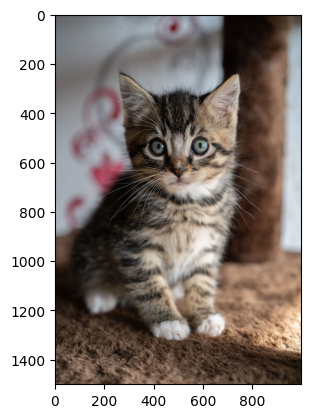

In [9]:
## PLAYGROUND: have a look at an example image
img: TVTensor = tv.io.read_image("/content/kitten.jpg")
plt.imshow(to_plottable(img));

Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 129MB/s]


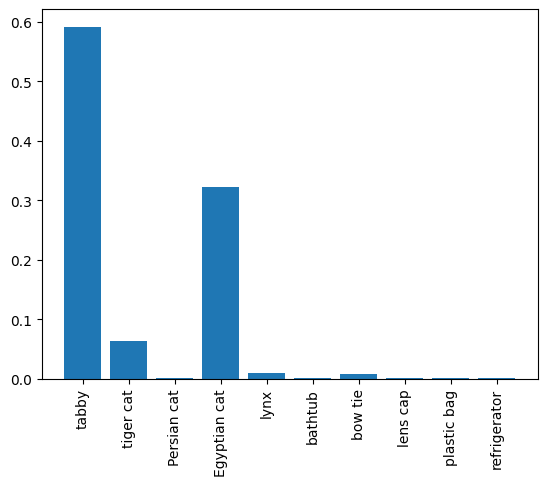

In [10]:
## PLAYGROUND to explore the model prediction.

## Define the model
#weights = models.ResNet50_Weights.DEFAULT
weights = models.AlexNet_Weights.DEFAULT
#model: torch.nn.Module = models.resnet50(weights=weights).eval()
model: torch.nn.Module = models.alexnet(weights=weights).eval()
data_preproc = weights.transforms() ## model-specific data preprocessing function
categories = weights.meta["categories"] ## names of output classes; here: ImageNet classes
my_model = my_model_from(model)

preproc_img: TVTensor = data_preproc(img).unsqueeze(0)
prediction = my_model(preproc_img)

predicted_class_id = get_predicted_class_id(prediction)
predicted_class = categories[predicted_class_id]
predicted_class, predicted_class_id

def show_probs(pred: List[float], categories: List[str] = categories):
    #score_per_class = zip([categories, pred_vals])
    plt.xticks(rotation='vertical')
    plt.bar(x=categories, height=pred)

# Get and show the predicted probabilities for the 10 best classes:
quantile = np.quantile(prediction, 0.99)
preds, cats = zip(*[(pred, categories[i]) for i, pred in enumerate(prediction) if pred > quantile])
show_probs(preds, cats)

/usr/local/lib/python3.10/dist-packages/captum/_utils/gradient.py:57: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(


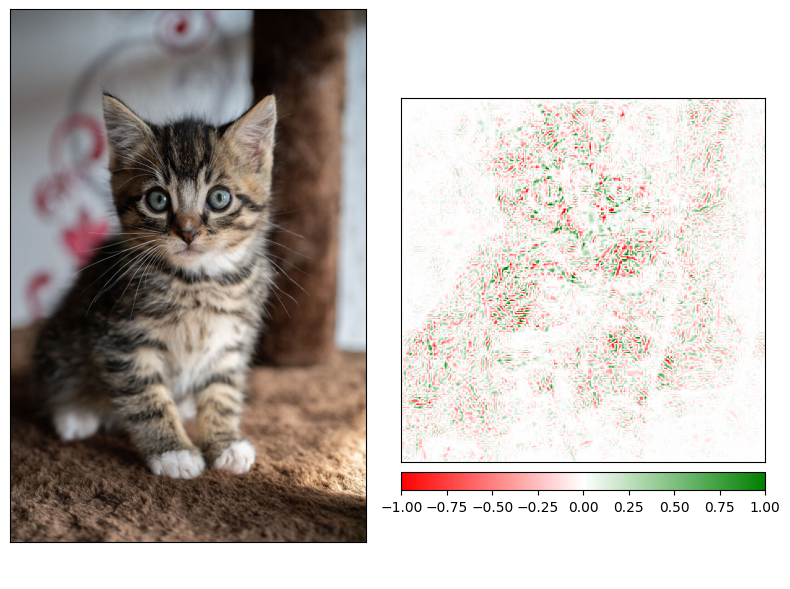

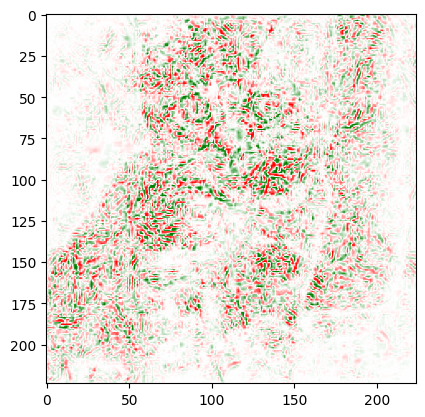

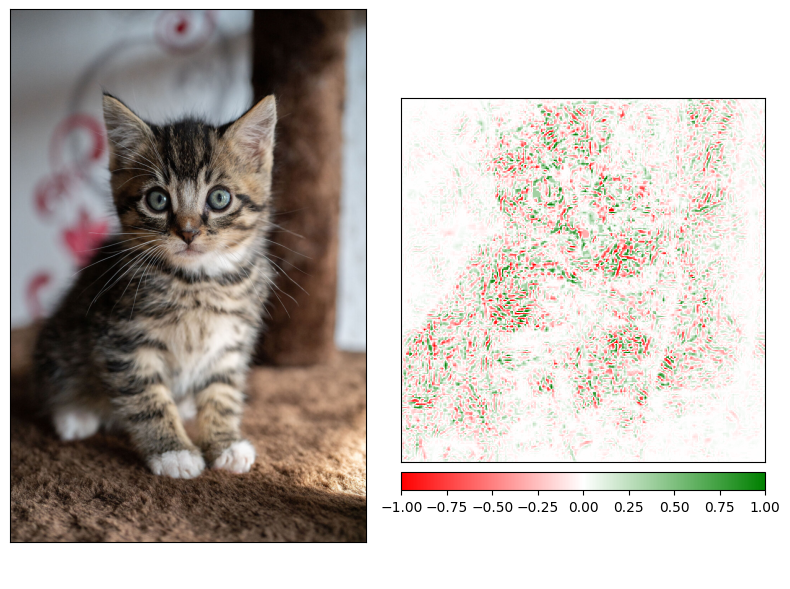

unique (norm->poster): tensor([-6.7363e-01, -3.2399e-01, -1.8982e-01, -1.1351e-01, -6.6435e-02,
        -3.6178e-02, -1.5490e-02, -4.7885e-04,  1.4499e-02,  3.5034e-02,
         6.5452e-02,  1.1267e-01,  1.9029e-01,  3.2619e-01,  6.8293e-01])


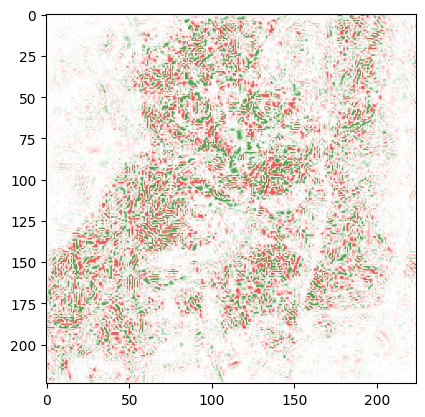

In [11]:
## Playground: Inspect the LRP outputs (they produce scores per pixel per channel, not only per pixel)
explainer = LRP(model)
explanation = explainer.attribute(preproc_img, target=predicted_class_id).squeeze(0)
_ = viz.visualize_image_attr_multiple(to_plottable(explanation),
                                      to_plottable(img),
                                      ["original_image", "heat_map"],
                                      ["all", "all"],
                                      show_colorbar=True,
                                      outlier_perc=2)
## compare to the reduction to per-pixel scores:
plot_attr(to_normalized_attr(explanation))

## Now have a look at the posterized LRP outputs:
## first posterize, then normalize
explanation_posterized = posterize(explanation)
_ = viz.visualize_image_attr_multiple(to_plottable(explanation_posterized),
                                      to_plottable(img),
                                      ["original_image", "heat_map"],
                                      ["all", "all"],
                                      show_colorbar=True,
                                      outlier_perc=2)
## first normalize, then posterize:
pp_explanation_posterized = posterize(to_normalized_attr(explanation), steps=15)
print("unique (norm->poster):", pp_explanation_posterized.unique())
plot_attr(pp_explanation_posterized)
plt.show()

In [12]:
## COLLECT the results (for one image)

def collect_class_predictions_under_masking(preproc_img: torch.Tensor, my_model, my_explainer, plot = False, **attr_kwargs):

    ## Get the target class ID
    clean_prediction = my_model(preproc_img)
    class_id = get_predicted_class_id(clean_prediction)

    ## Get explanation for the class
    pp_explanation_posterized = my_explainer(preproc_img, model=my_model, target_class_id=class_id, **attr_kwargs)
    if plot:
        plt.title("Explanation (red=-, green=+)")
        plot_attr(pp_explanation_posterized)
        plt.show()
    ## Assume this only has few used values (e.g., is posterized or uses super-pixels);
    ## define each the set of pixels belonging to the same value as (maskable) feature.
    values, indices = torch.unique(pp_explanation_posterized, return_inverse=True)
    if plot:
        plt.title("Values per bin after posterization")
        plt.bar(range(len(values)), height=values)
        plt.show()

    ## Collect the decreasing class predictions when masking
    class_predictions = [] ## tuples of (<#features removed>, <predicted class probability>)
    features_removed = []
    best_classes = [] ## list of the string name of the currently best class (collected out of interest)
    for i in range(len(values), 0, -1):
        ## Masking magic :-)
        masked_img = preproc_img - preproc_img*(indices.unsqueeze(0)>=i)
        prediction = my_model(masked_img)
        class_prediction = prediction[class_id]
        best_class = categories[np.argmax(prediction)] ## collected out of interest

        class_predictions.append(class_prediction)
        features_removed.append(len(values)-i)
        best_classes.append(best_class)

        ## How does the masked image look like after masking the n most important features?
        if plot:
            to_plot = to_plottable(masked_img)
            print(to_plot.shape)
            plt.title(f"{len(values)-i} features removed ({class_prediction:.2e}, curr best: {best_class})")
            plt.imshow(to_plot)
            plt.show()

    return {
        "class_predictions": class_predictions,
        "nums_features_removed": features_removed,
        "best_classes": best_classes
        }



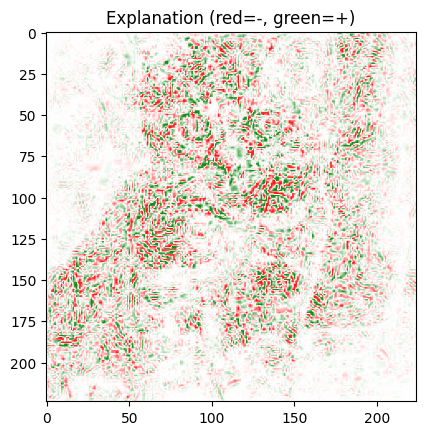

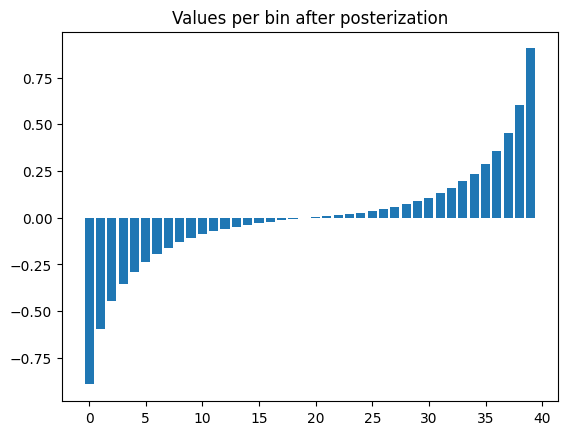

(224, 224, 3)


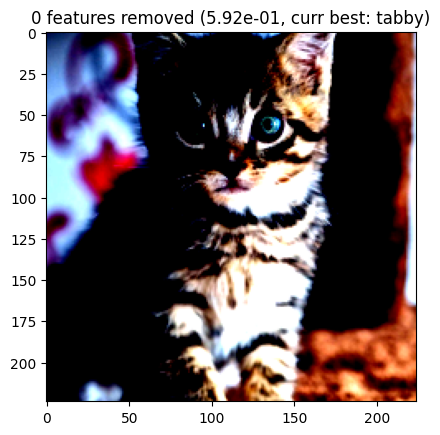

(224, 224, 3)


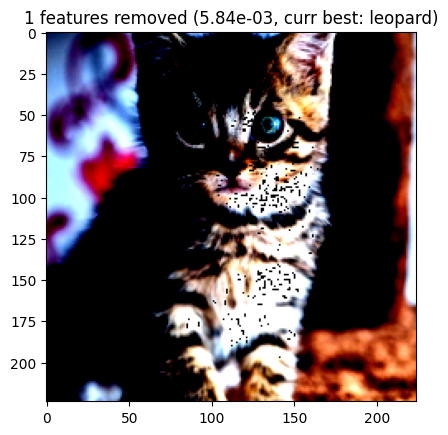

(224, 224, 3)


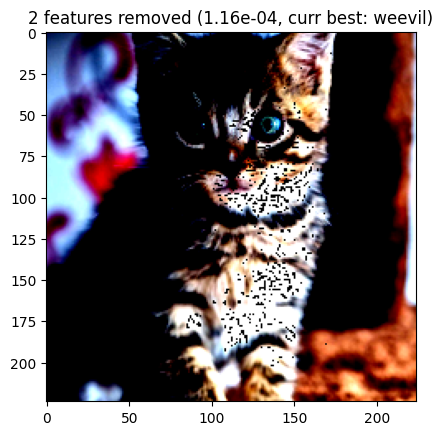

(224, 224, 3)


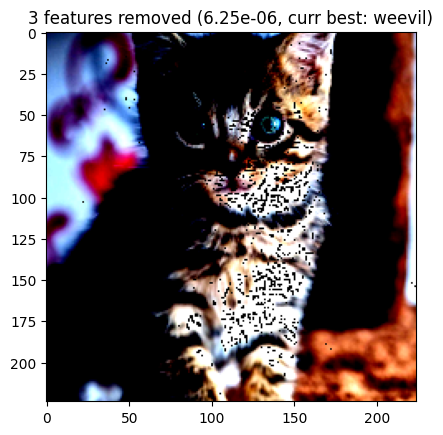

(224, 224, 3)


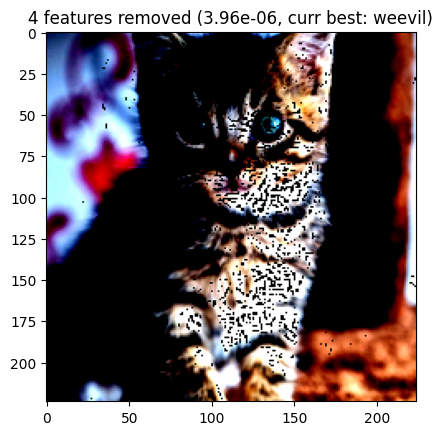

(224, 224, 3)


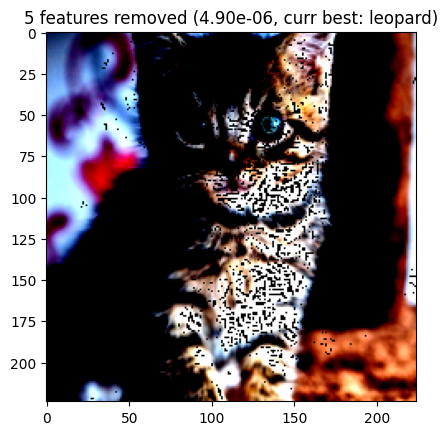

(224, 224, 3)


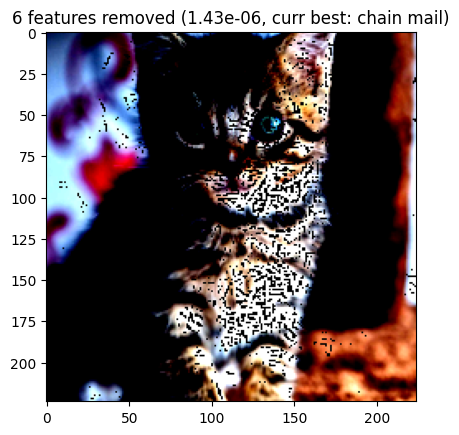

(224, 224, 3)


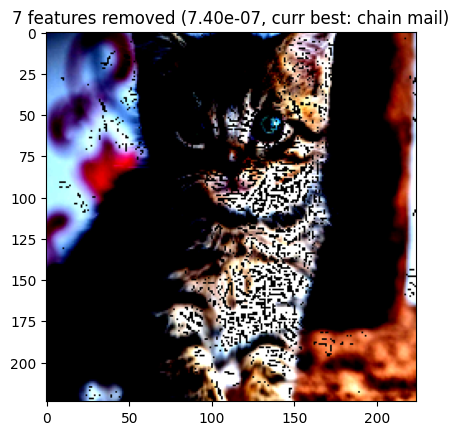

(224, 224, 3)


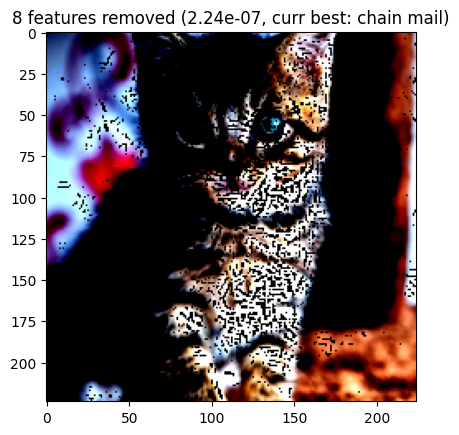

(224, 224, 3)


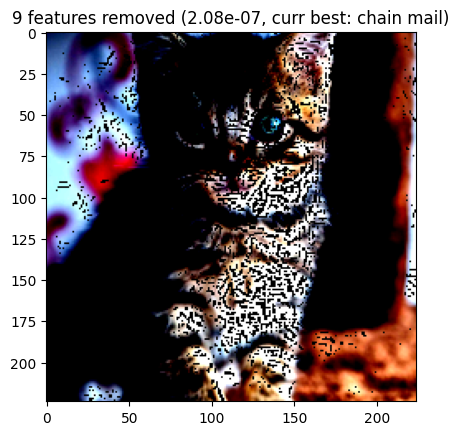

(224, 224, 3)


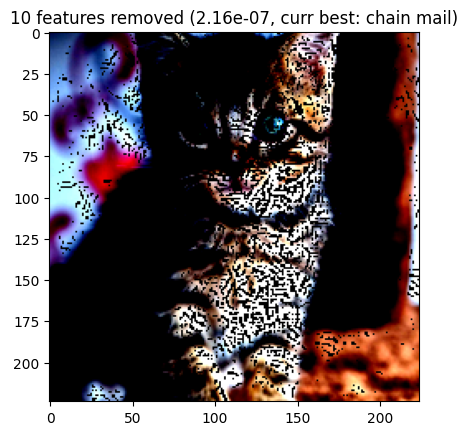

(224, 224, 3)


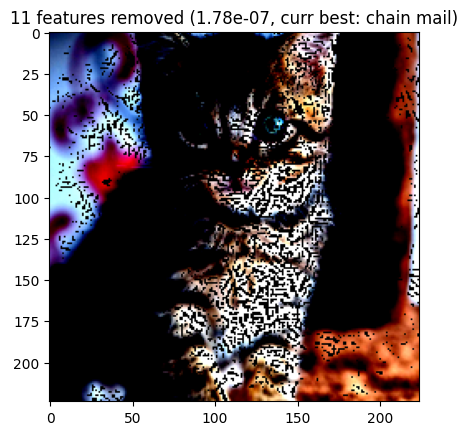

(224, 224, 3)


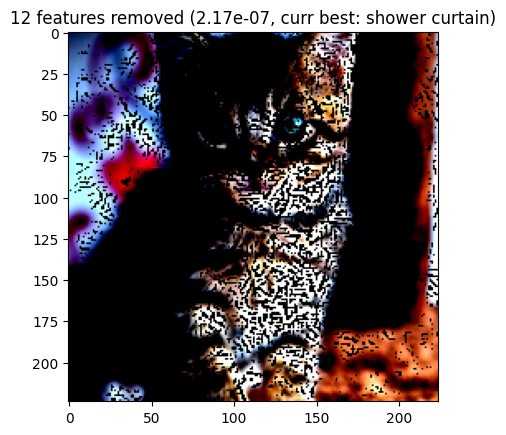

(224, 224, 3)


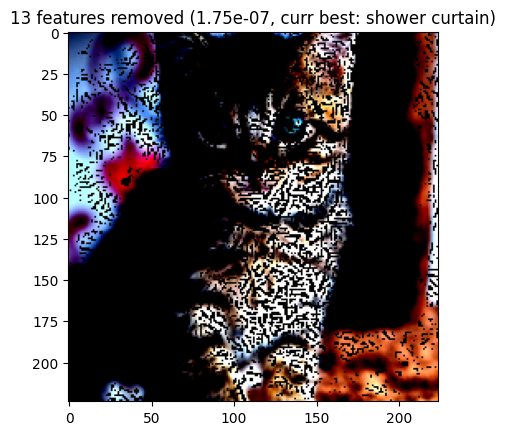

(224, 224, 3)


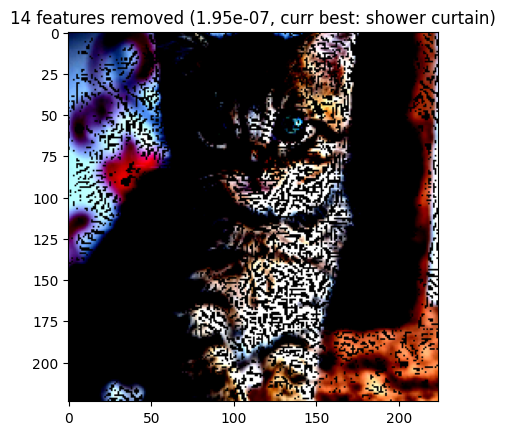

(224, 224, 3)


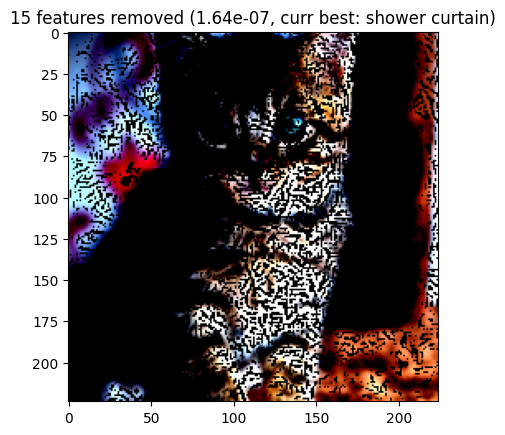

(224, 224, 3)


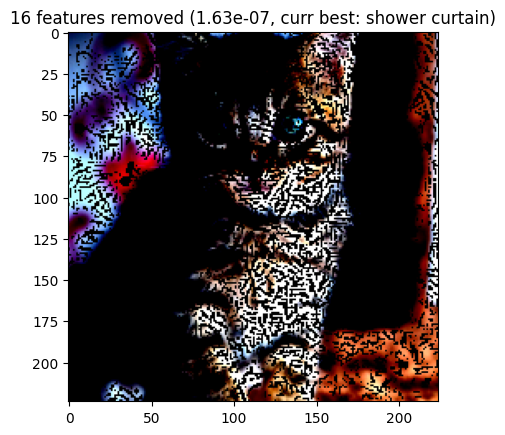

(224, 224, 3)


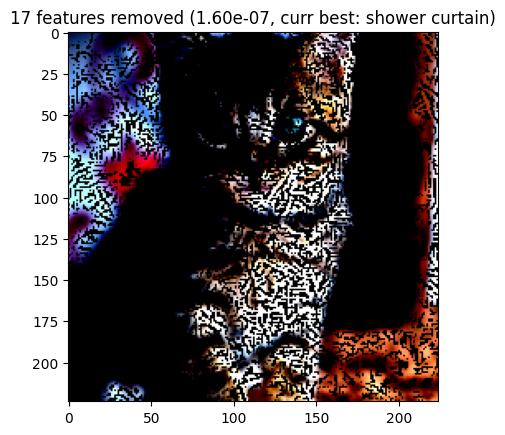

(224, 224, 3)


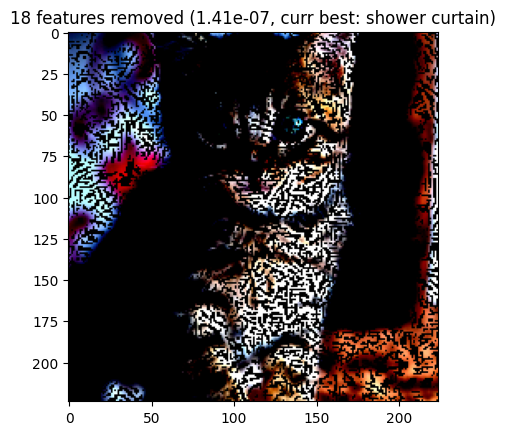

(224, 224, 3)


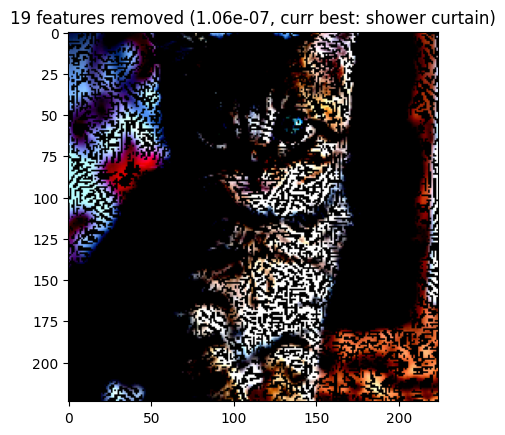

(224, 224, 3)


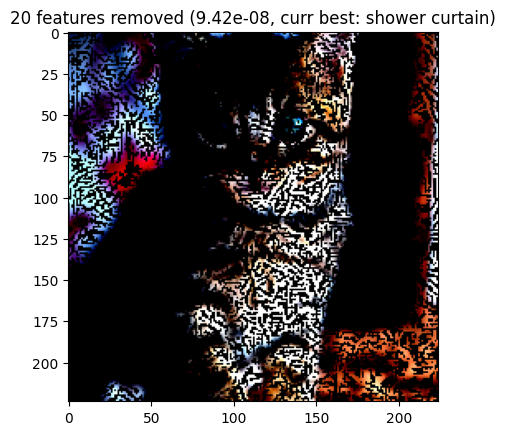

(224, 224, 3)


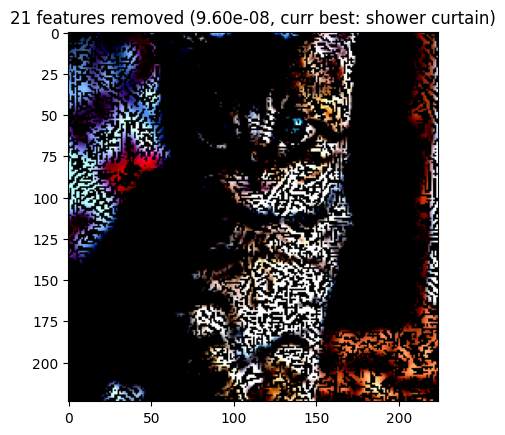

(224, 224, 3)


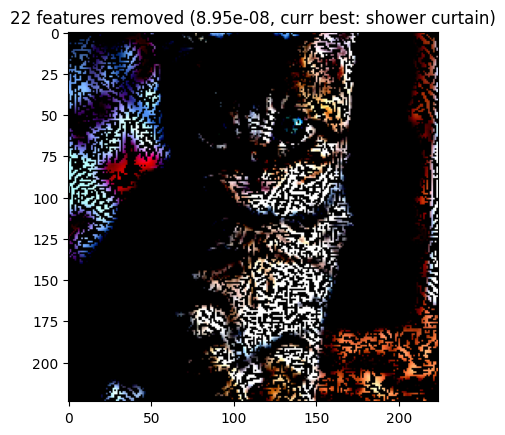

(224, 224, 3)


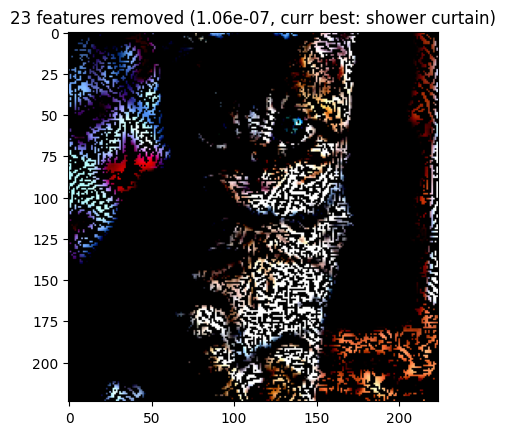

(224, 224, 3)


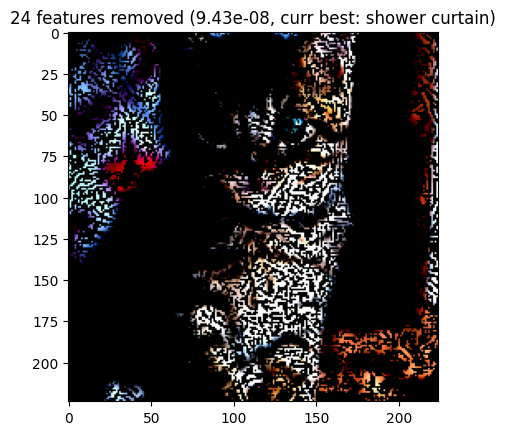

(224, 224, 3)


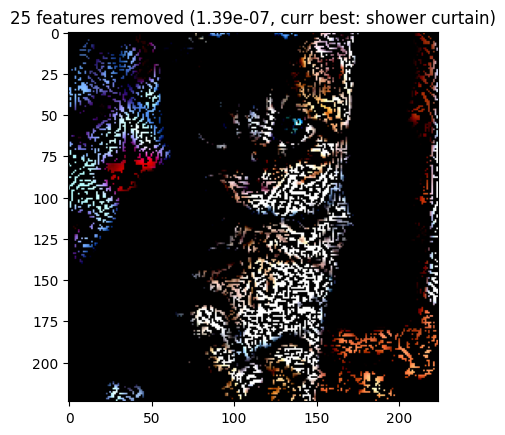

(224, 224, 3)


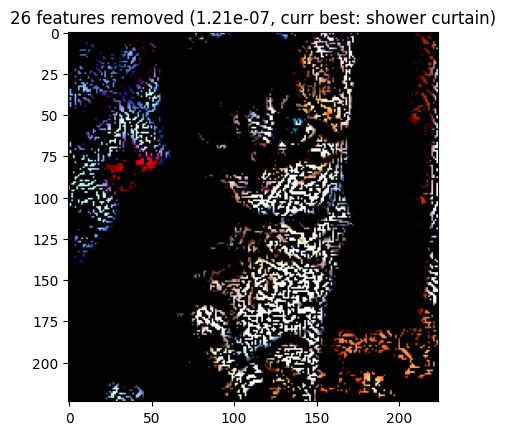

(224, 224, 3)


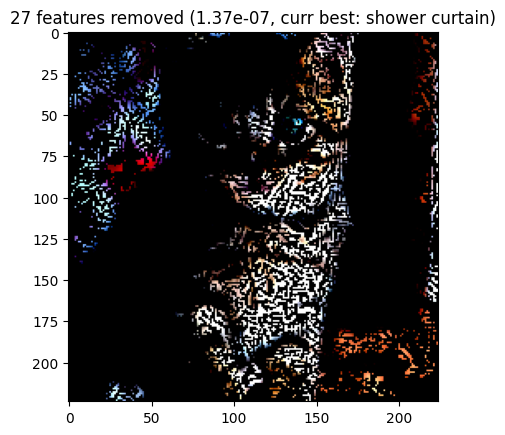

(224, 224, 3)


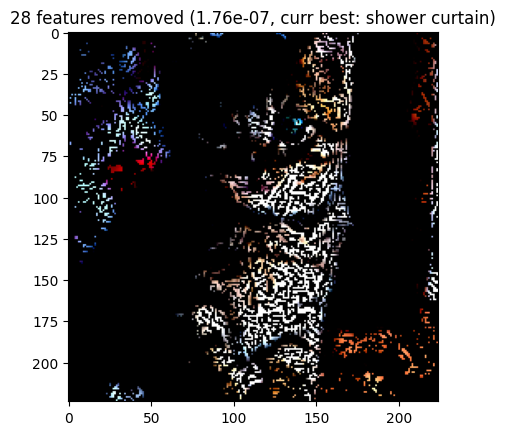

(224, 224, 3)


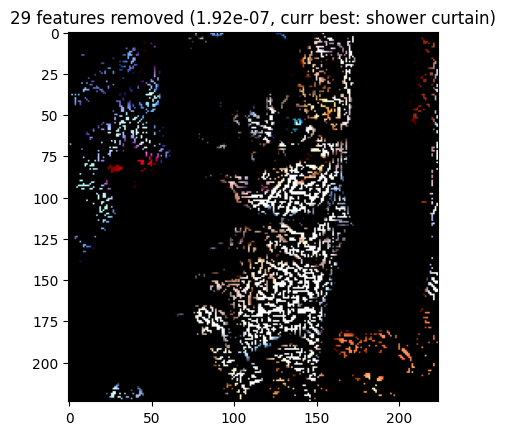

(224, 224, 3)


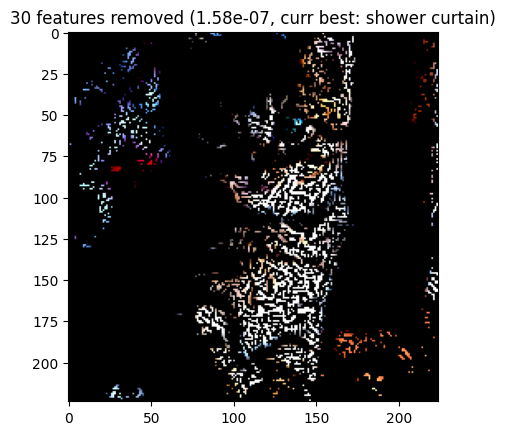

(224, 224, 3)


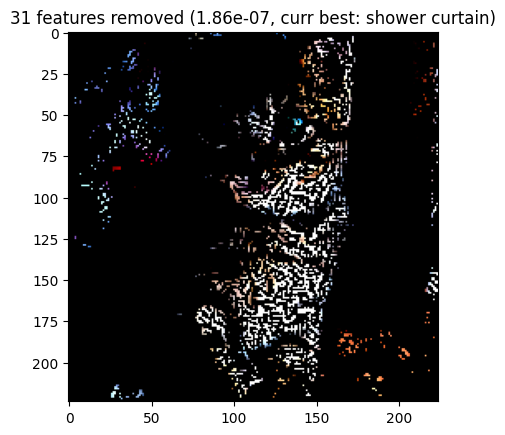

(224, 224, 3)


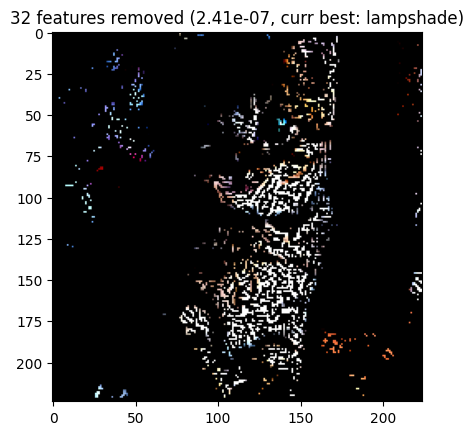

(224, 224, 3)


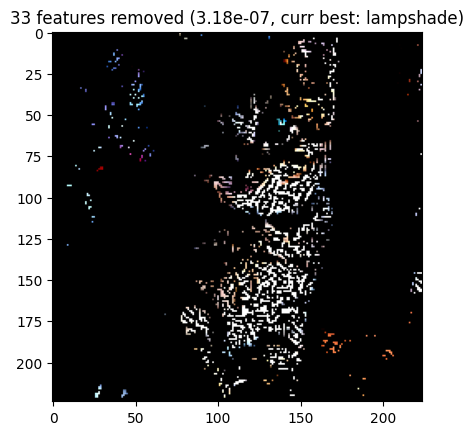

(224, 224, 3)


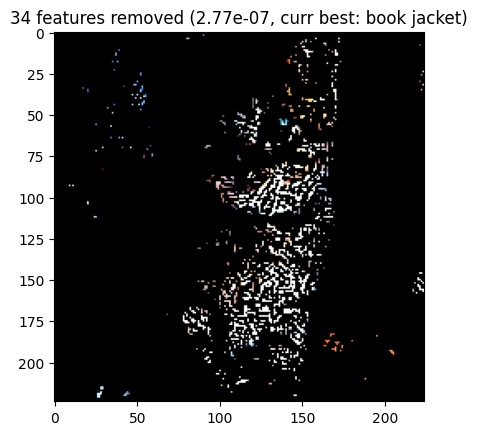

(224, 224, 3)


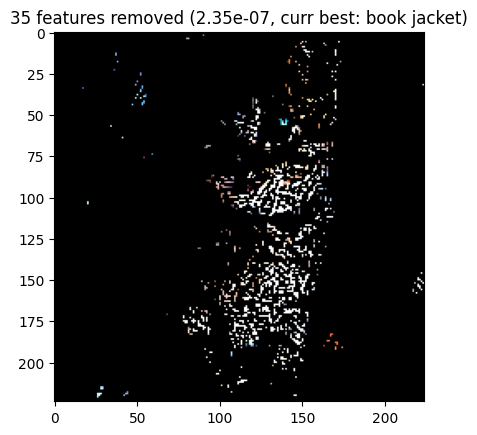

(224, 224, 3)


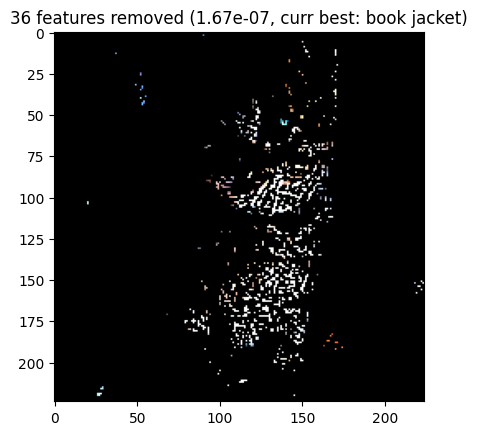

(224, 224, 3)


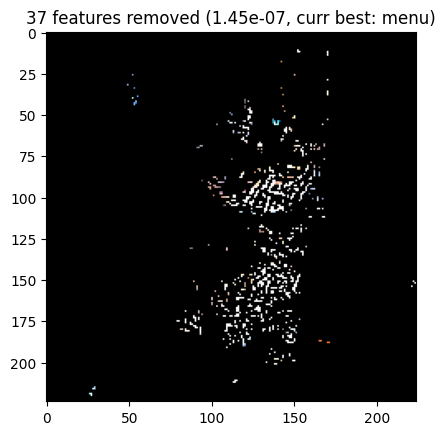

(224, 224, 3)


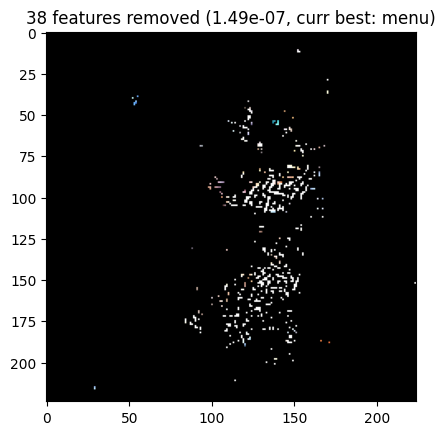

(224, 224, 3)


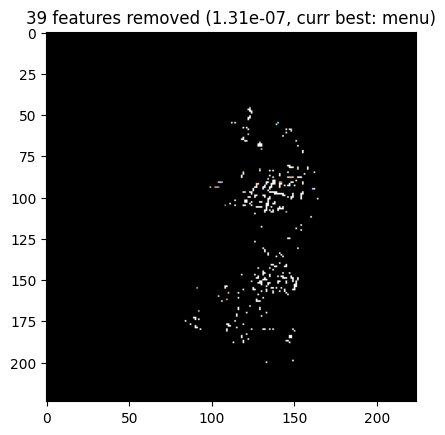

AUC:  0.3019978404045105
Predicted labels after each step:  ['tabby', 'leopard', 'weevil', 'weevil', 'weevil', 'leopard', 'chain mail', 'chain mail', 'chain mail', 'chain mail', 'chain mail', 'chain mail', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'lampshade', 'lampshade', 'book jacket', 'book jacket', 'book jacket', 'menu', 'menu', 'menu']


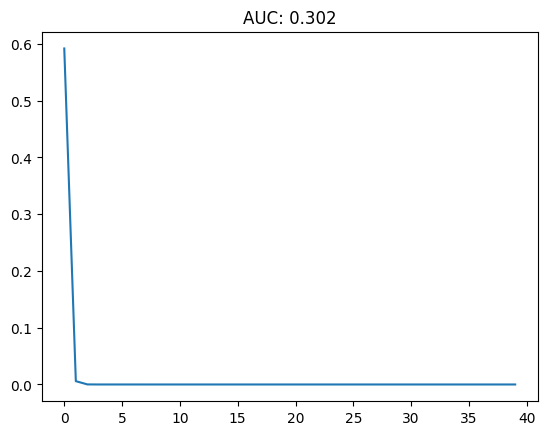

In [13]:
## COLLECT the results for a given image
## LRP, AlexNet on ImageNet

## Model & explainer
weights = models.AlexNet_Weights.DEFAULT
model: torch.nn.Module = models.alexnet(weights=weights).eval()
data_preproc = weights.transforms() ## model-specific data preprocessing function
categories = weights.meta["categories"] ## names of output classes; here: ImageNet classes
my_model = my_model_from(model)
my_explainer = my_explainer_from(LRP(model))

## Get image
img: TVTensor = tv.io.read_image("kitten.jpg")
preproc_img: TVTensor = data_preproc(img).unsqueeze(0)

## Get results
results = collect_class_predictions_under_masking(preproc_img, my_model=my_model, my_explainer=my_explainer, plot=True)

## Evaluate the results
metric = torcheval.metrics.AUC()
metric.update(torch.tensor(results["nums_features_removed"]), torch.tensor(results["class_predictions"]))
auc = metric.compute().item()
print("AUC: ", auc)

## Show the plot how the class probability decreases with increasing masking steps
plt.title(f"AUC: {auc:.5}")
plt.plot(results["nums_features_removed"], results["class_predictions"])
print("Predicted labels after each step: ", results["best_classes"]) ## when did the cat seize to be cat-like?

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 151MB/s]


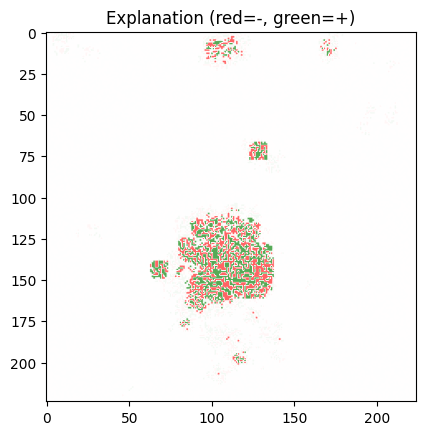

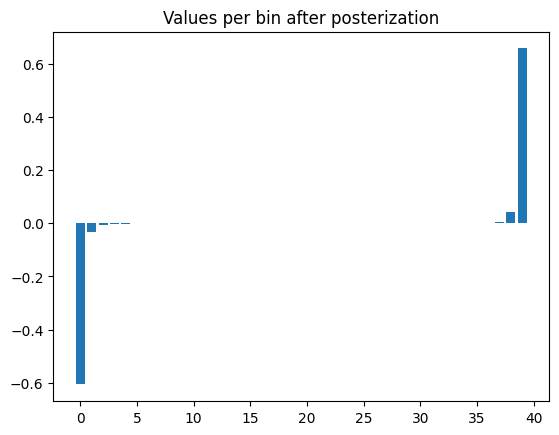

(224, 224, 3)


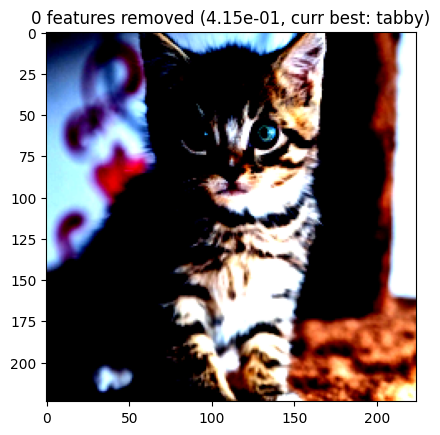

(224, 224, 3)


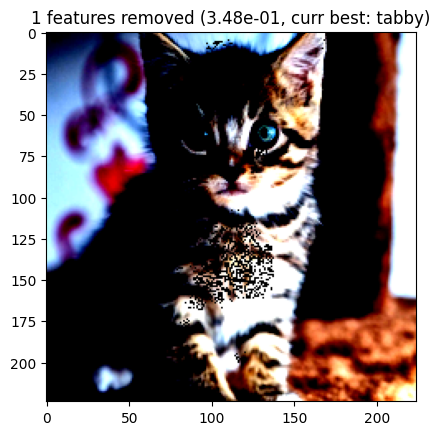

(224, 224, 3)


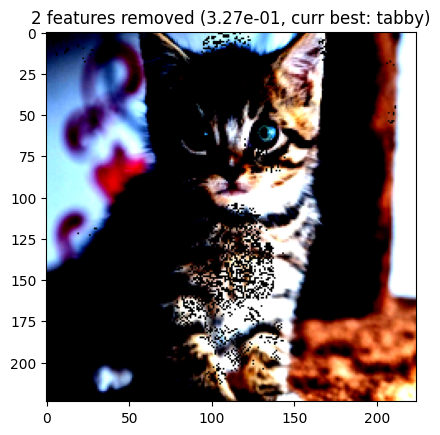

(224, 224, 3)


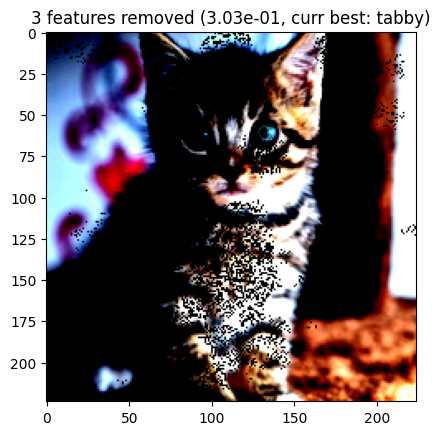

(224, 224, 3)


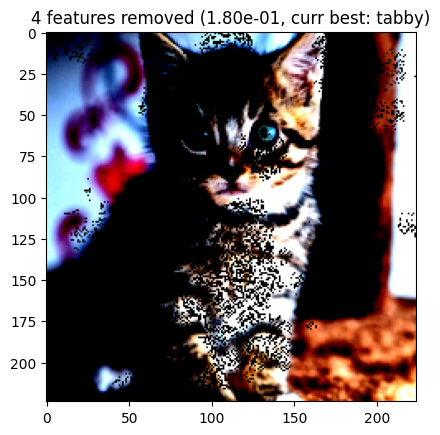

(224, 224, 3)


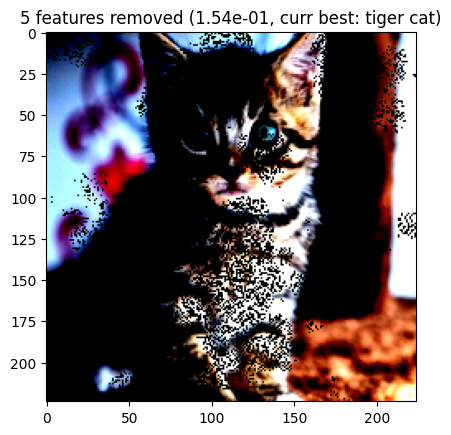

(224, 224, 3)


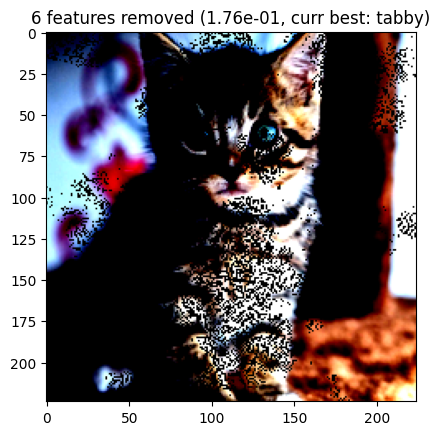

(224, 224, 3)


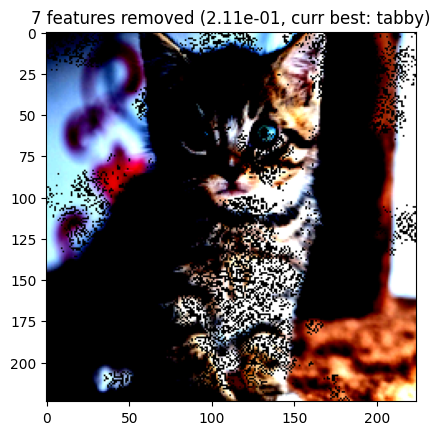

(224, 224, 3)


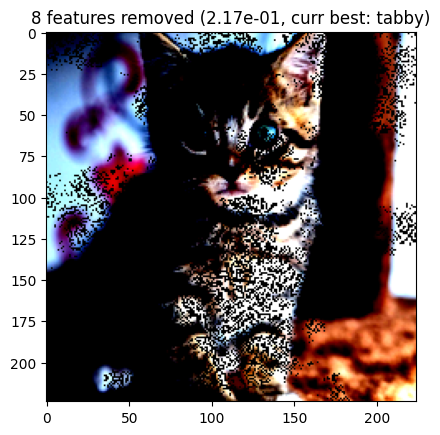

(224, 224, 3)


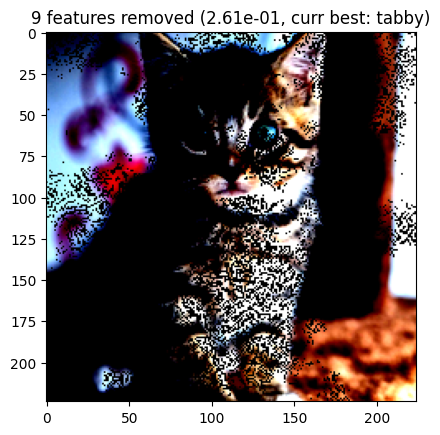

(224, 224, 3)


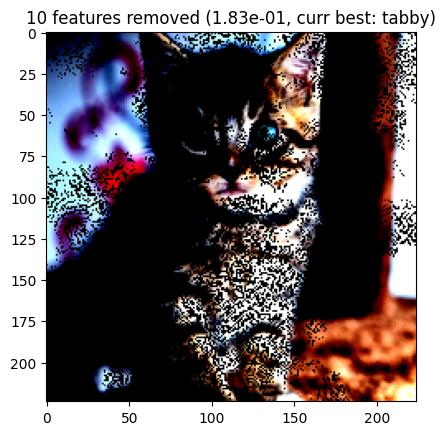

(224, 224, 3)


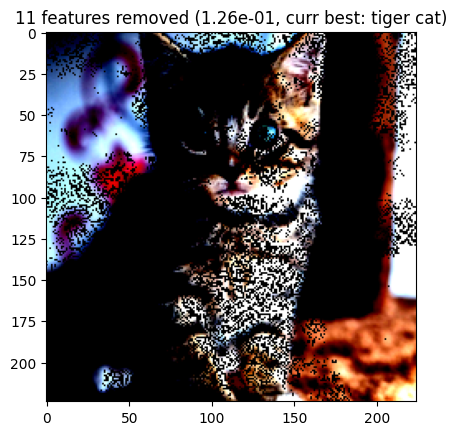

(224, 224, 3)


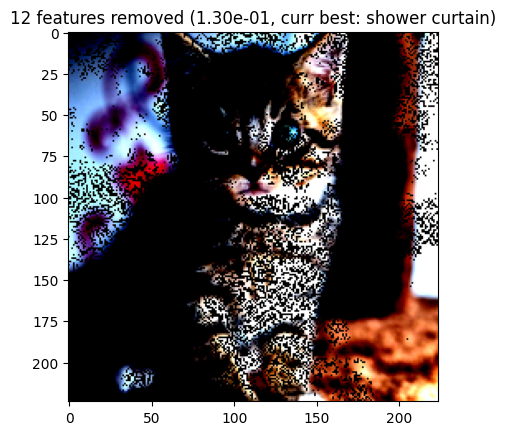

(224, 224, 3)


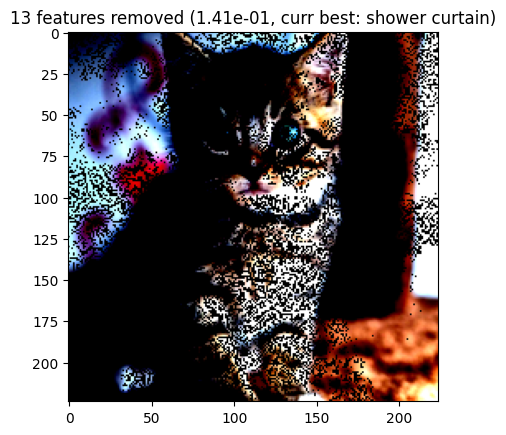

(224, 224, 3)


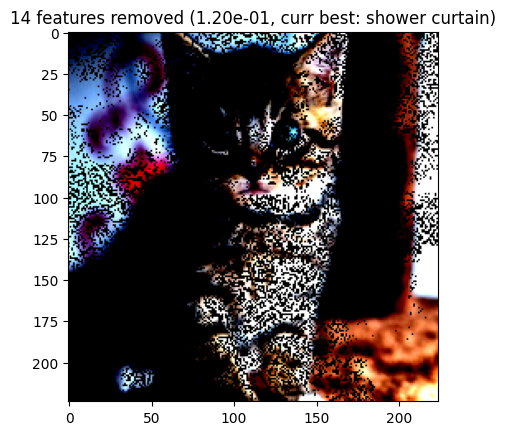

(224, 224, 3)


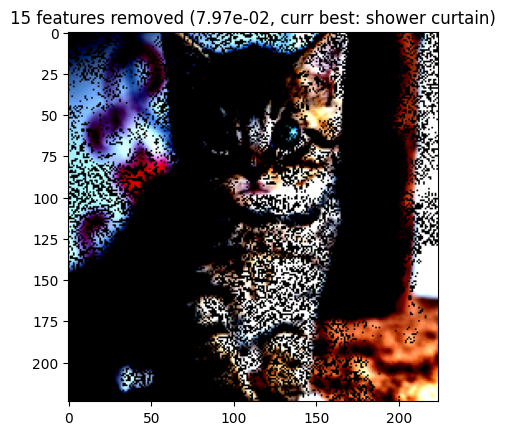

(224, 224, 3)


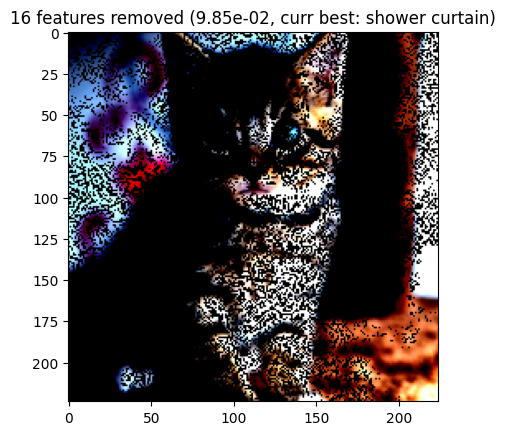

(224, 224, 3)


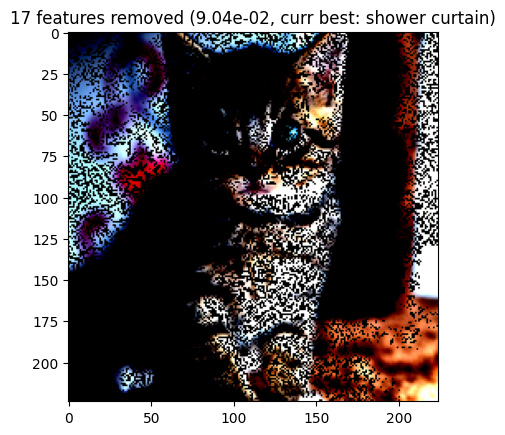

(224, 224, 3)


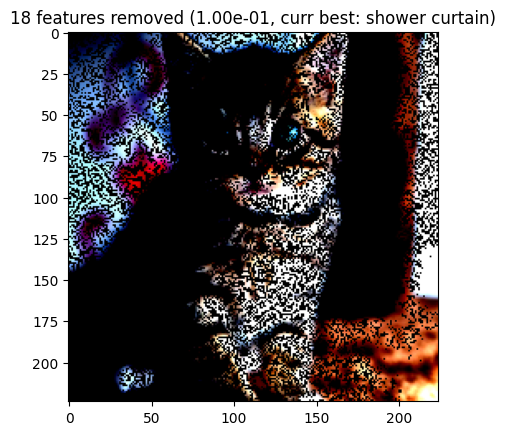

(224, 224, 3)


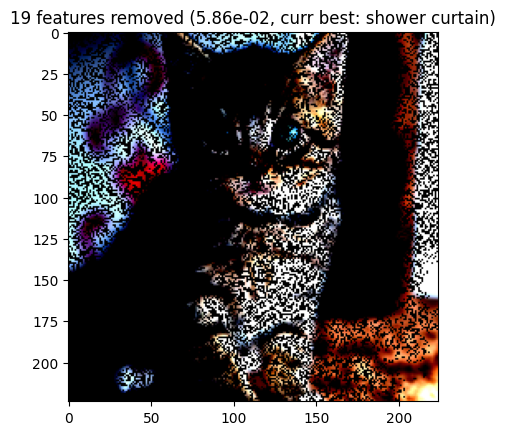

(224, 224, 3)


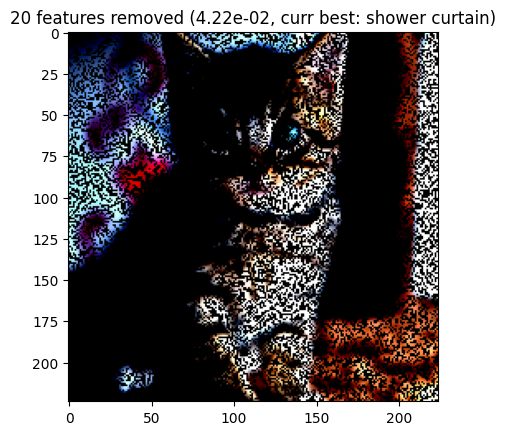

(224, 224, 3)


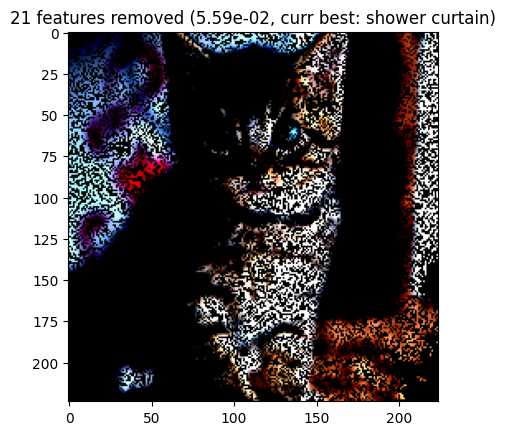

(224, 224, 3)


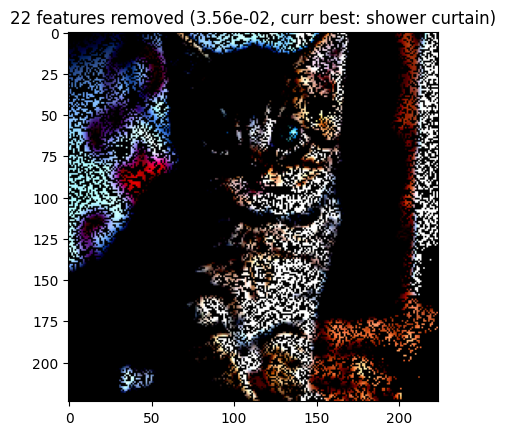

(224, 224, 3)


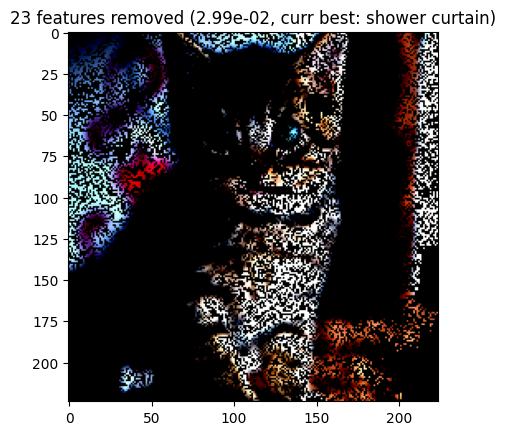

(224, 224, 3)


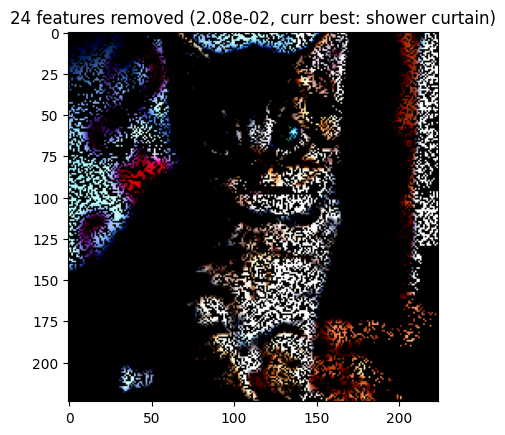

(224, 224, 3)


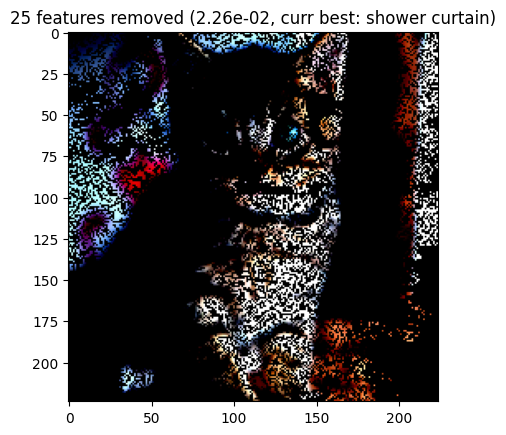

(224, 224, 3)


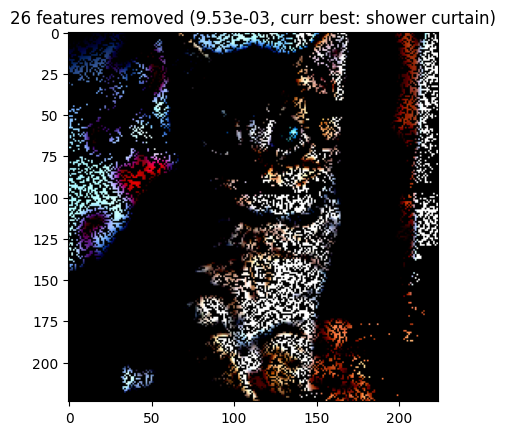

(224, 224, 3)


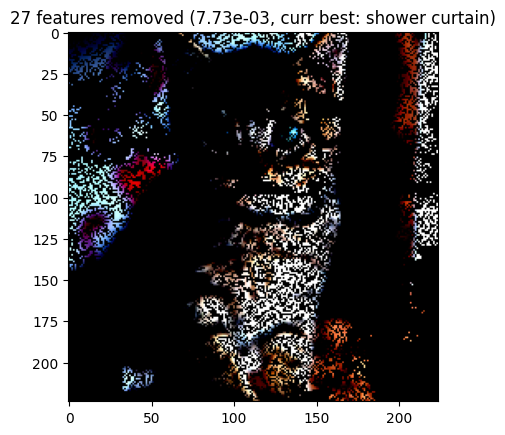

(224, 224, 3)


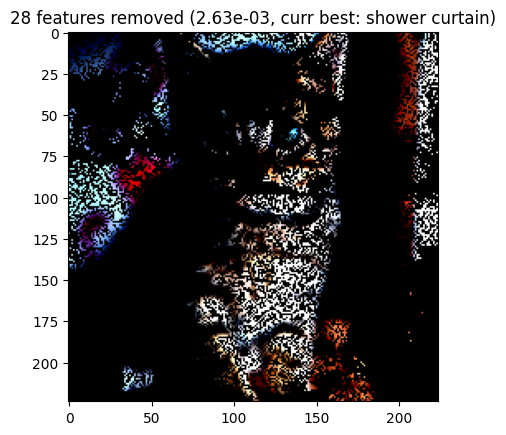

(224, 224, 3)


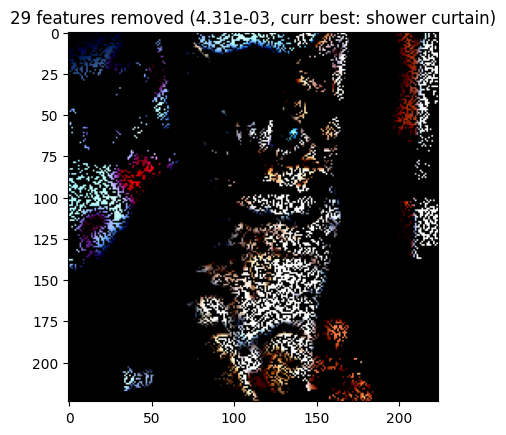

(224, 224, 3)


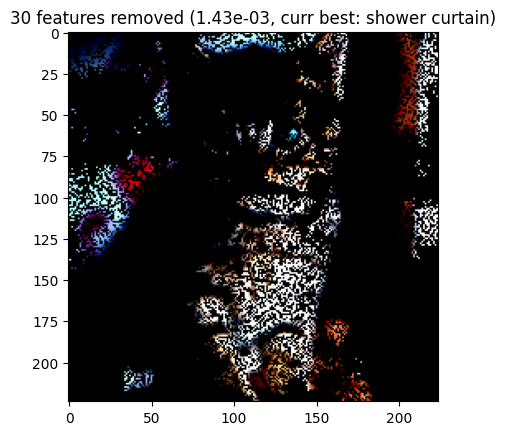

(224, 224, 3)


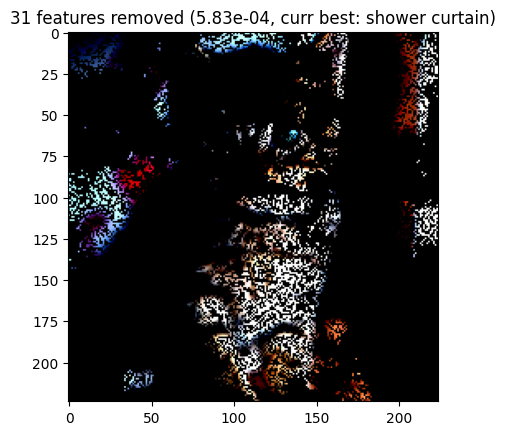

(224, 224, 3)


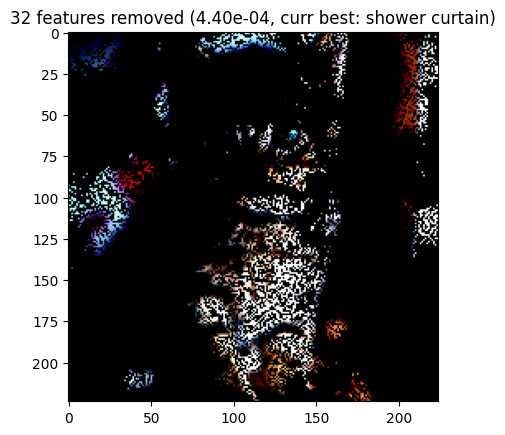

(224, 224, 3)


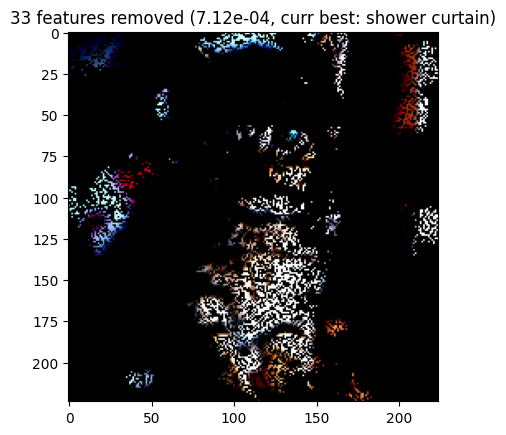

(224, 224, 3)


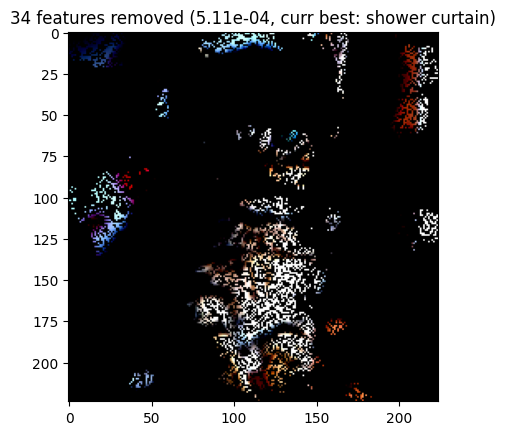

(224, 224, 3)


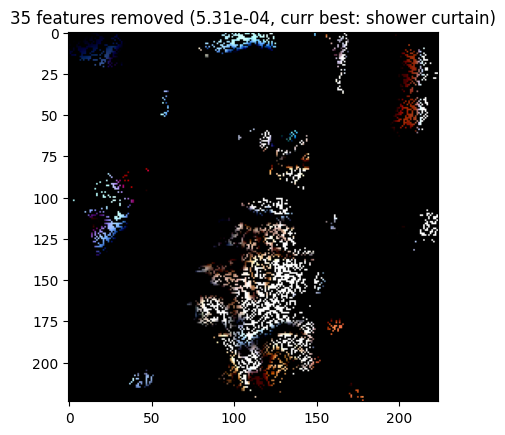

(224, 224, 3)


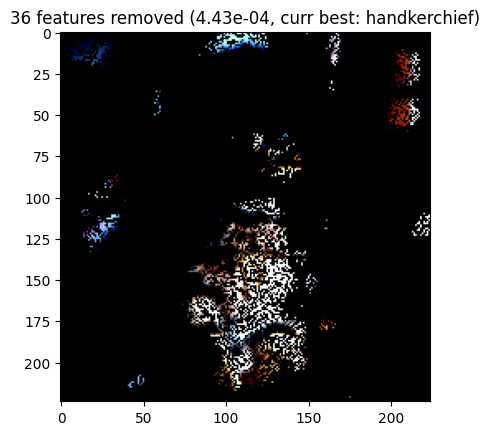

(224, 224, 3)


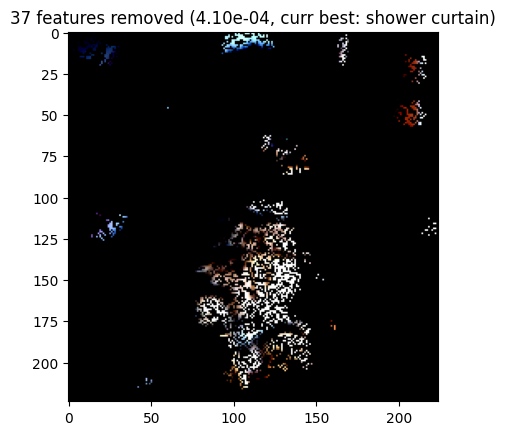

(224, 224, 3)


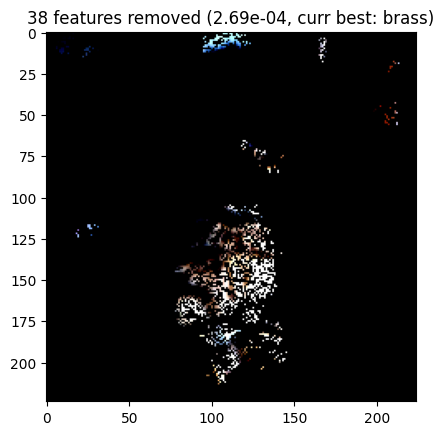

(224, 224, 3)


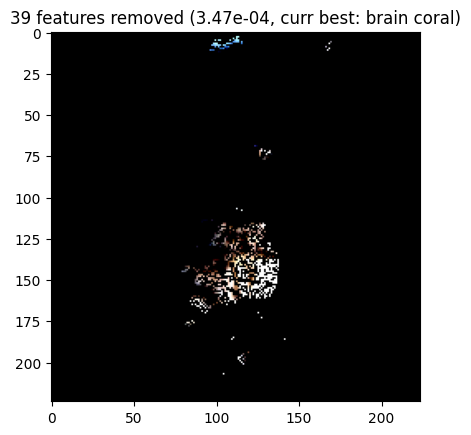

AUC:  3.749152660369873
Predicted labels after each step:  ['tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tiger cat', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tiger cat', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'shower curtain', 'handkerchief', 'shower curtain', 'brass', 'brain coral']


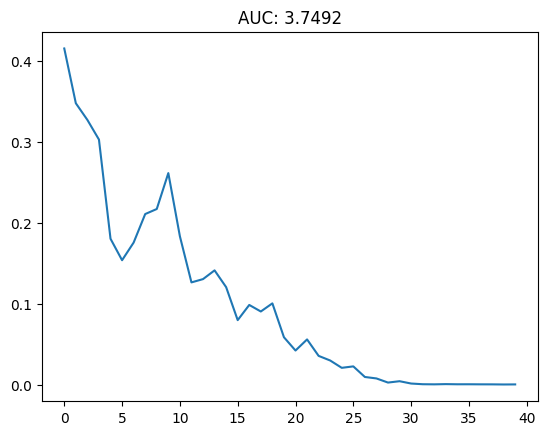

In [14]:
## COLLECT the results for a given image
## LRP, ResNet50 on ImageNet

## Model & Explainer
weights = models.ResNet50_Weights.DEFAULT
model: torch.nn.Module = models.resnet50(weights=weights).eval()
data_preproc = weights.transforms() ## model-specific data preprocessing function
categories = weights.meta["categories"] ## names of output classes; here: ImageNet classes
my_model = my_model_from(model)
my_explainer = my_explainer_from(LRP(model))

## Get image
img: TVTensor = tv.io.read_image("kitten.jpg")
preproc_img: TVTensor = data_preproc(img).unsqueeze(0)

## Get results
results = collect_class_predictions_under_masking(preproc_img, my_model=my_model, my_explainer=my_explainer, plot=True)

## Evaluate the results
metric = torcheval.metrics.AUC()
metric.update(torch.tensor(results["nums_features_removed"]), torch.tensor(results["class_predictions"]))
auc = metric.compute().item()
print("AUC: ", auc)

## Show the plot how the class probability decreases with increasing masking steps
plt.title(f"AUC: {auc:.5}")
plt.plot(results["nums_features_removed"], results["class_predictions"])
print("Predicted labels after each step: ", results["best_classes"]) ## when did the cat seize to be cat-like?

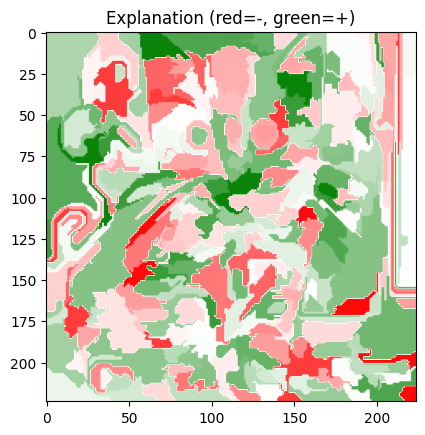

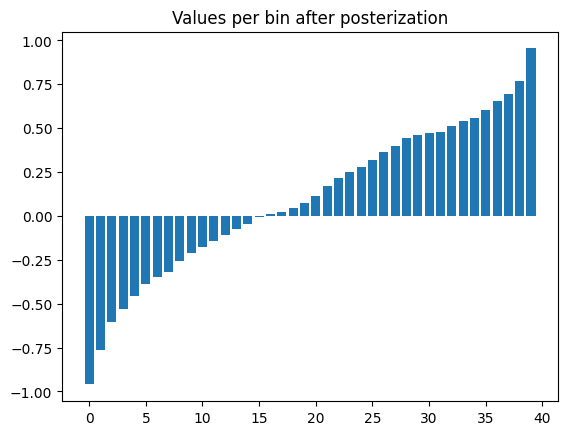

(224, 224, 3)


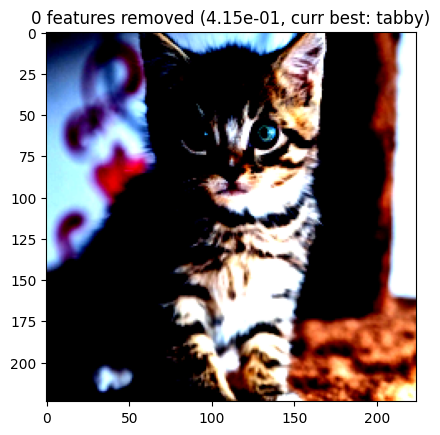

(224, 224, 3)


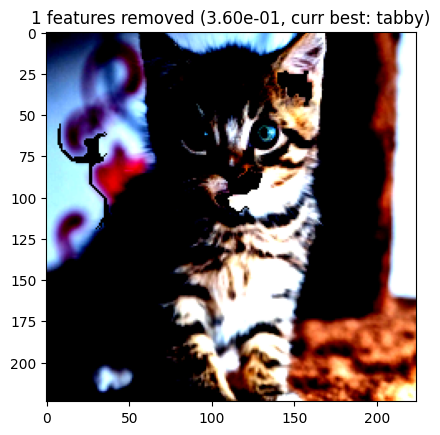

(224, 224, 3)


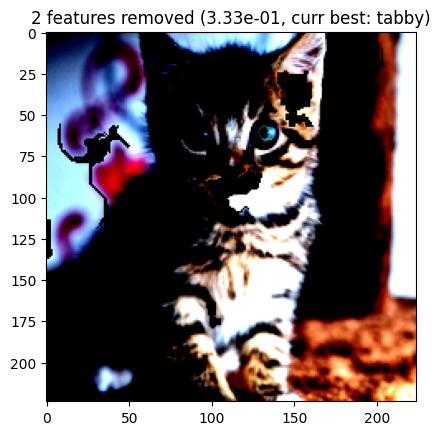

(224, 224, 3)


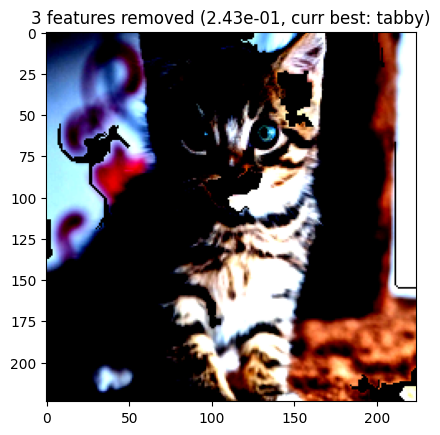

(224, 224, 3)


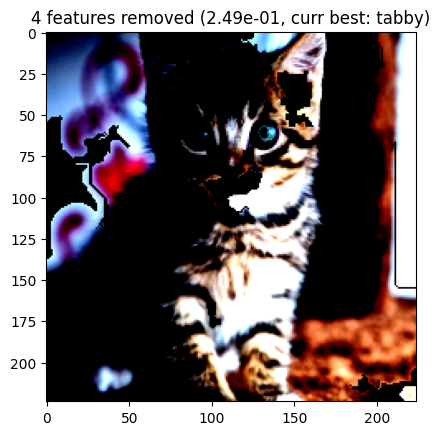

(224, 224, 3)


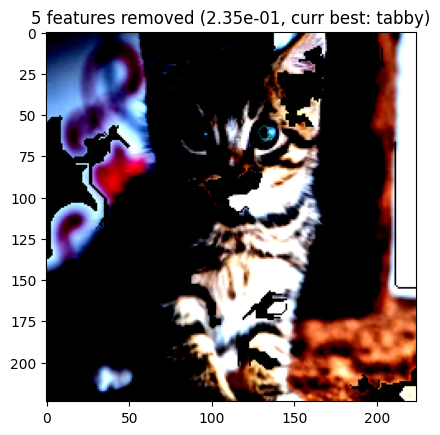

(224, 224, 3)


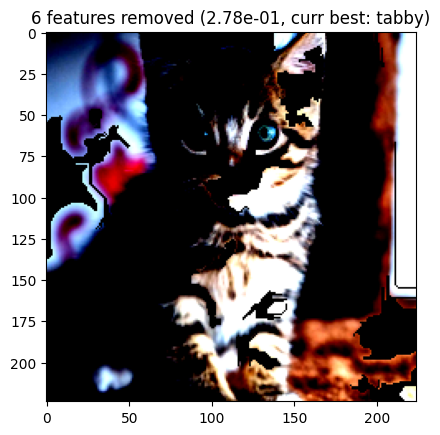

(224, 224, 3)


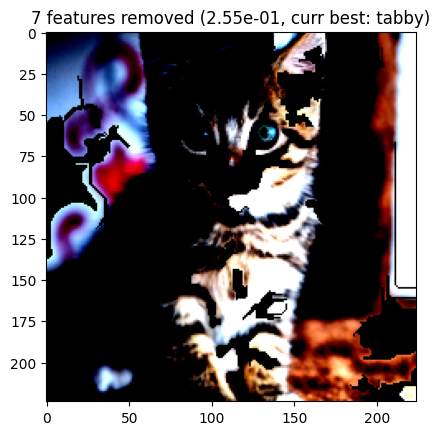

(224, 224, 3)


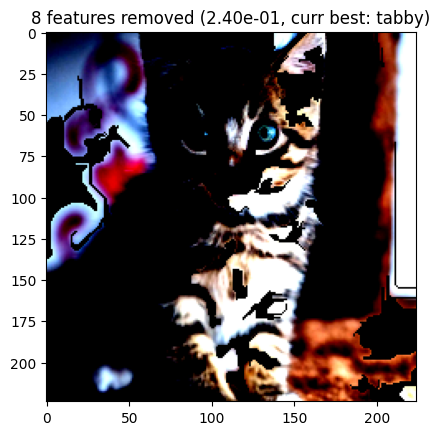

(224, 224, 3)


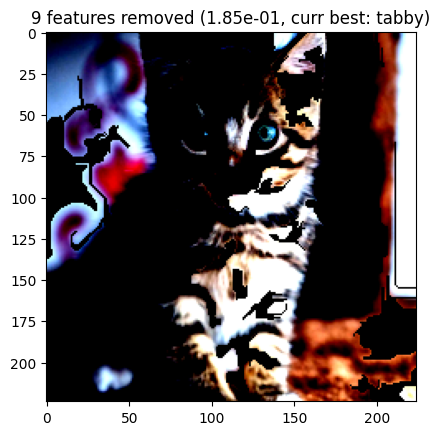

(224, 224, 3)


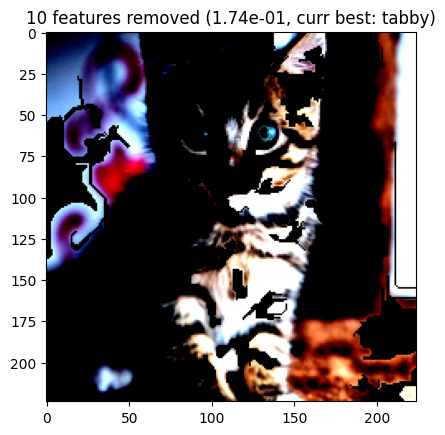

(224, 224, 3)


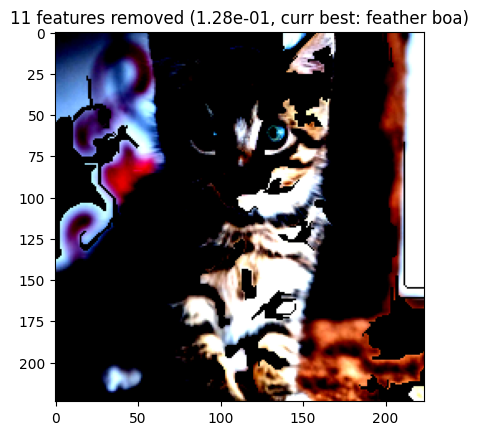

(224, 224, 3)


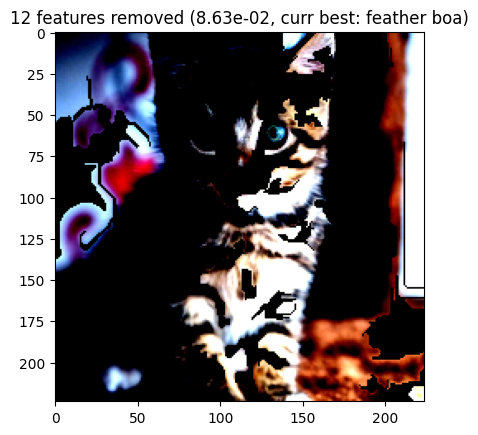

(224, 224, 3)


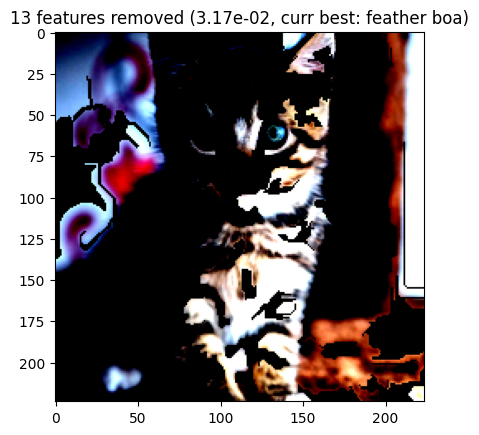

(224, 224, 3)


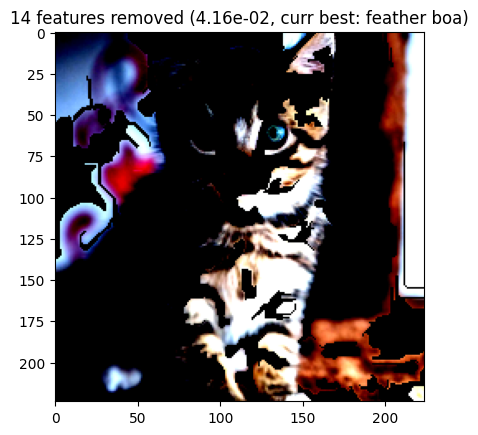

(224, 224, 3)


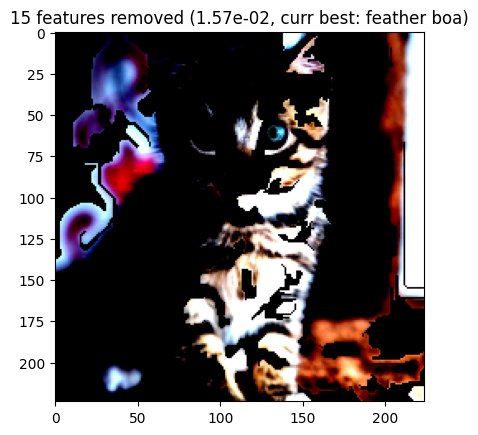

(224, 224, 3)


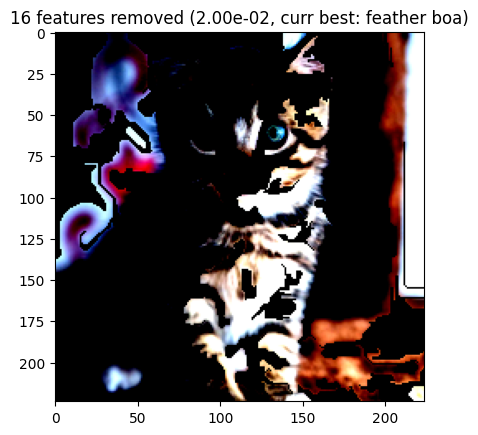

(224, 224, 3)


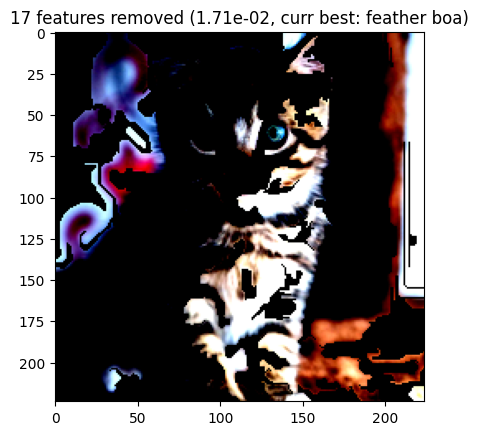

(224, 224, 3)


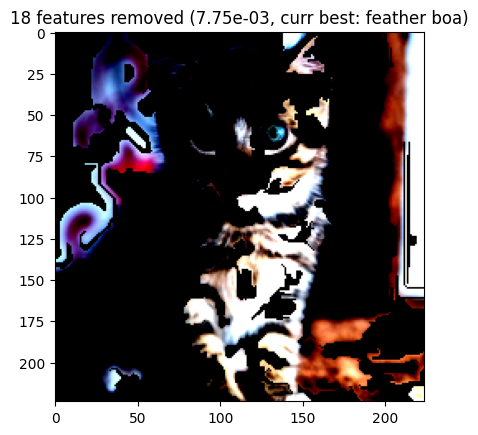

(224, 224, 3)


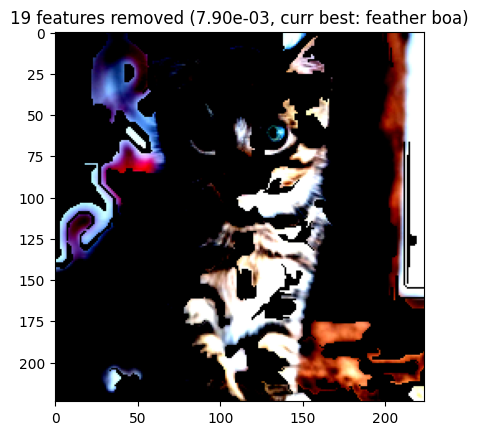

(224, 224, 3)


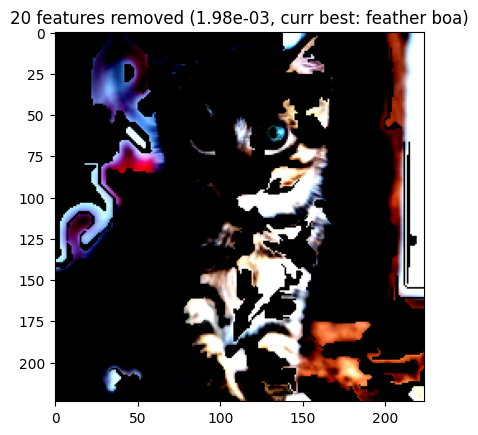

(224, 224, 3)


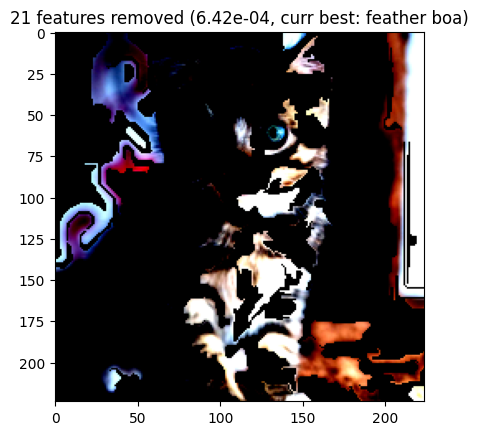

(224, 224, 3)


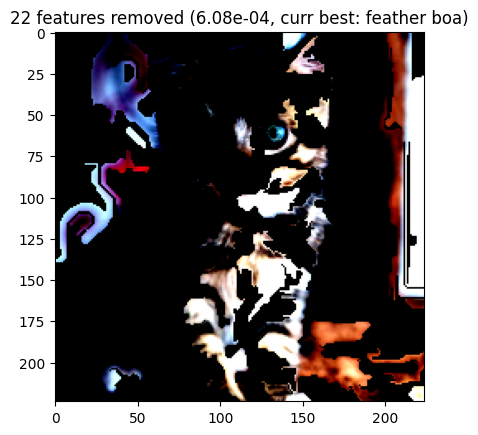

(224, 224, 3)


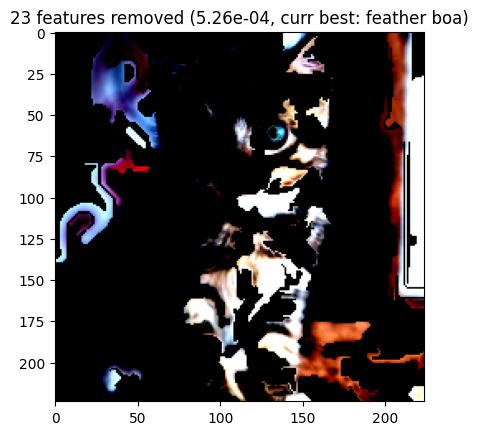

(224, 224, 3)


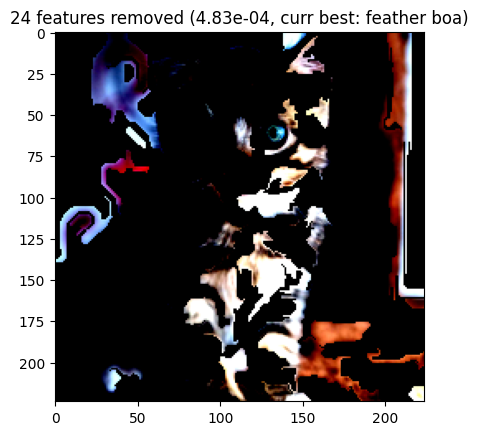

(224, 224, 3)


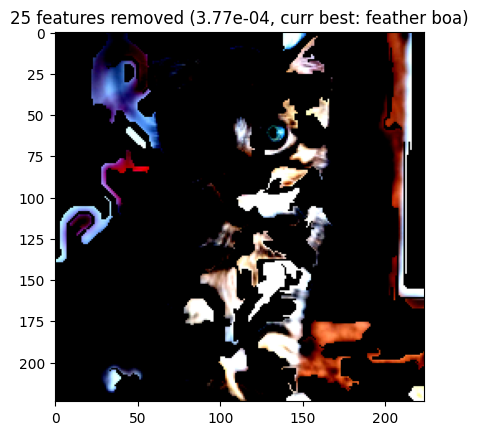

(224, 224, 3)


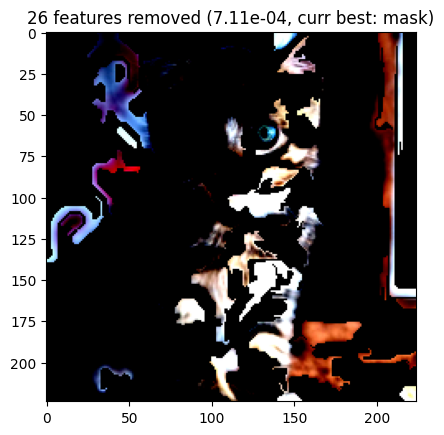

(224, 224, 3)


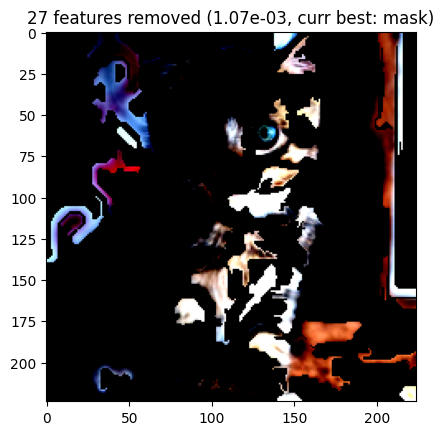

(224, 224, 3)


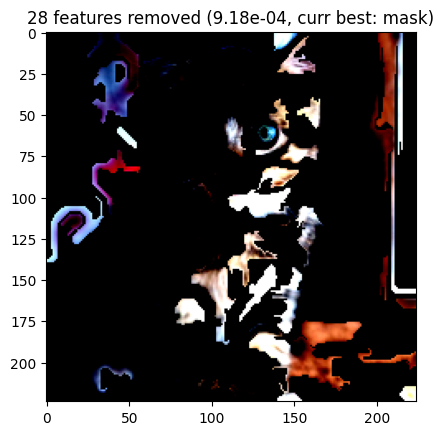

(224, 224, 3)


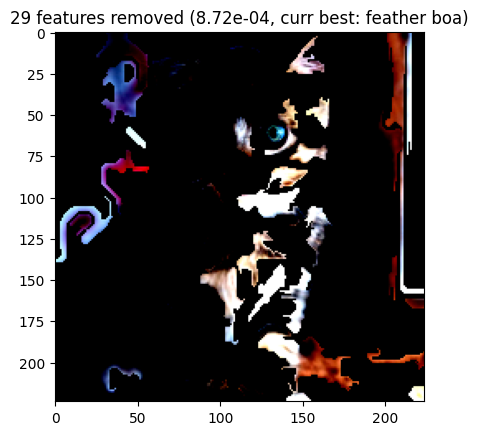

(224, 224, 3)


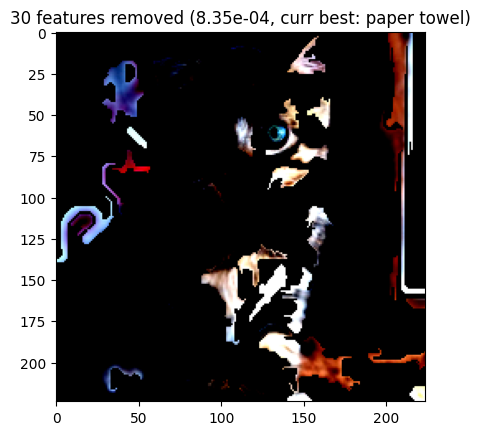

(224, 224, 3)


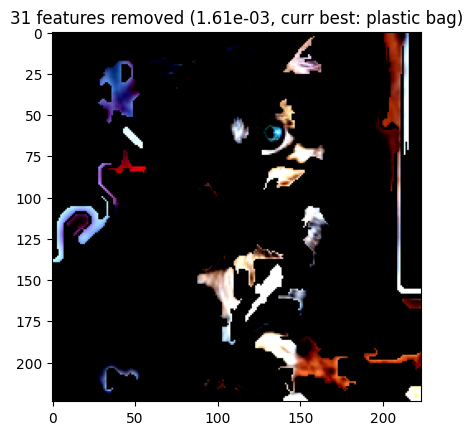

(224, 224, 3)


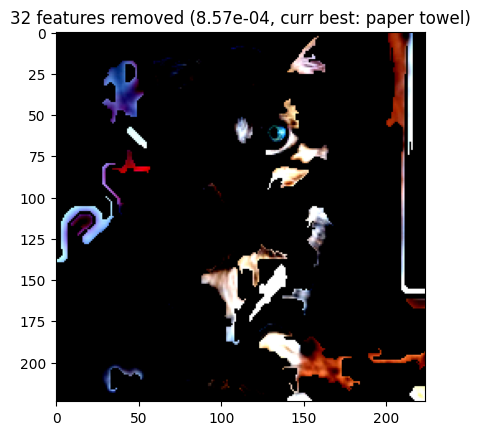

(224, 224, 3)


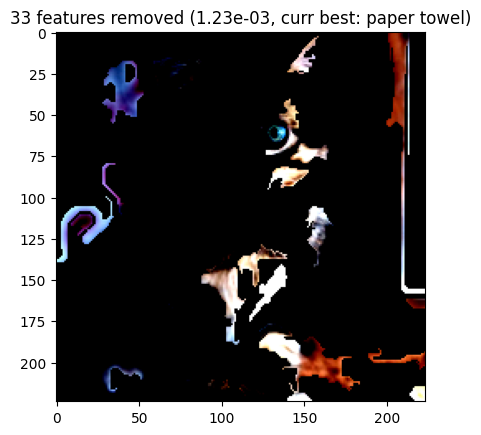

(224, 224, 3)


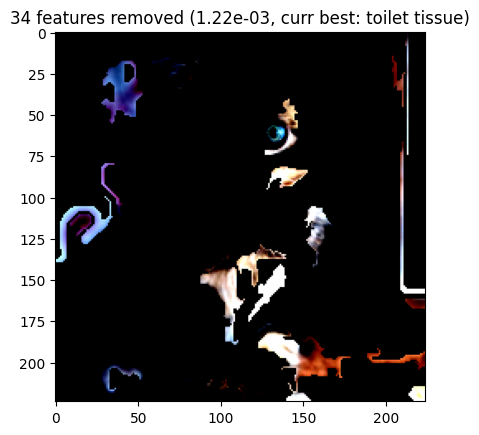

(224, 224, 3)


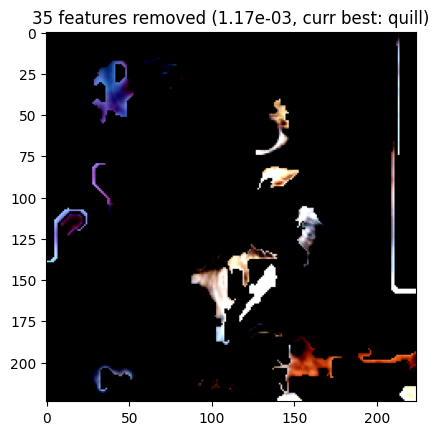

(224, 224, 3)


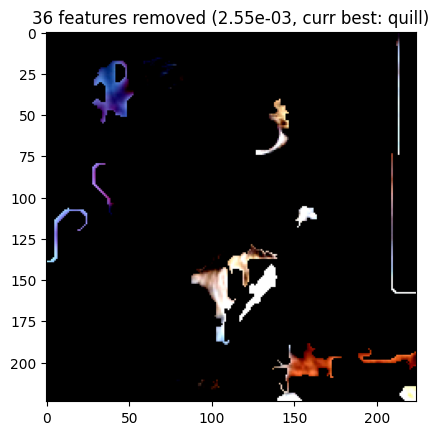

(224, 224, 3)


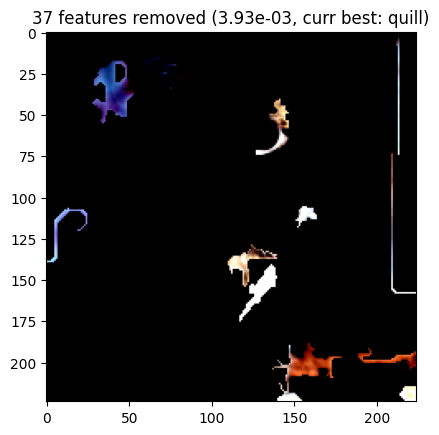

(224, 224, 3)


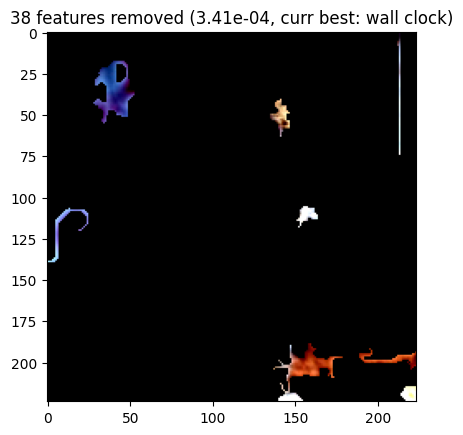

(224, 224, 3)


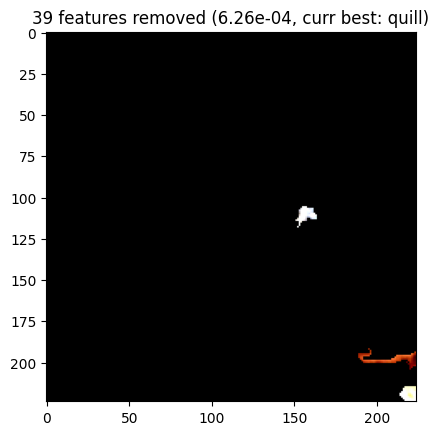

AUC:  3.1366207599639893
Predicted labels after each step:  ['tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'tabby', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'feather boa', 'mask', 'mask', 'mask', 'feather boa', 'paper towel', 'plastic bag', 'paper towel', 'paper towel', 'toilet tissue', 'quill', 'quill', 'quill', 'wall clock', 'quill']


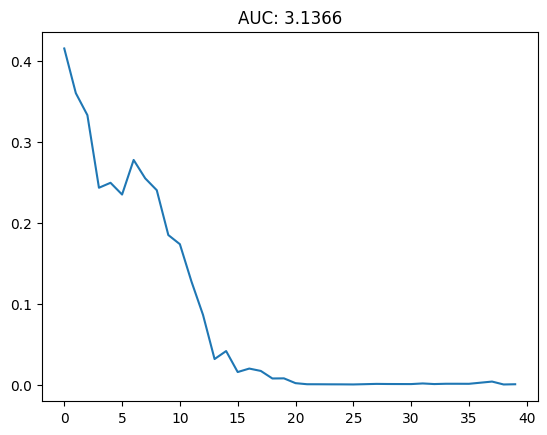

In [15]:
## COLLECT the results for a given image
## LIME, ResNet50 on ImageNet

## Model & Explainer
weights = models.ResNet50_Weights.DEFAULT
model: torch.nn.Module = models.resnet50(weights=weights).eval()
data_preproc = weights.transforms() ## model-specific data preprocessing function
categories = weights.meta["categories"] ## names of output classes; here: ImageNet classes
my_model = my_model_from(model)
my_explainer = my_explainer_from(Lime(model, SkLearnLinearModel("linear_model.Ridge")))

## Get image
img: TVTensor = tv.io.read_image("kitten.jpg")
preproc_img: TVTensor = data_preproc(img).unsqueeze(0)
## Create superpixels
segments_fz_np = felzenszwalb(to_plottable(preproc_img), scale=100, sigma=0.5, min_size=50) ## for alternative superpixeling algos see https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_segmentations.html
segments = torch.tensor(segments_fz_np).broadcast_to(3, *segments_fz_np.shape).unsqueeze(0)

## Get results
results = collect_class_predictions_under_masking(preproc_img, my_model=my_model, my_explainer=my_explainer, plot=True, feature_mask=segments)

## Evaluate the results
metric = torcheval.metrics.AUC()
metric.update(torch.tensor(results["nums_features_removed"]), torch.tensor(results["class_predictions"]))
auc = metric.compute().item()
print("AUC: ", auc)

## Show the plot how the class probability decreases with increasing masking steps
plt.title(f"AUC: {auc:.5}")
plt.plot(results["nums_features_removed"], results["class_predictions"])
print("Predicted labels after each step: ", results["best_classes"]) ## when did the cat seize to be cat-like?

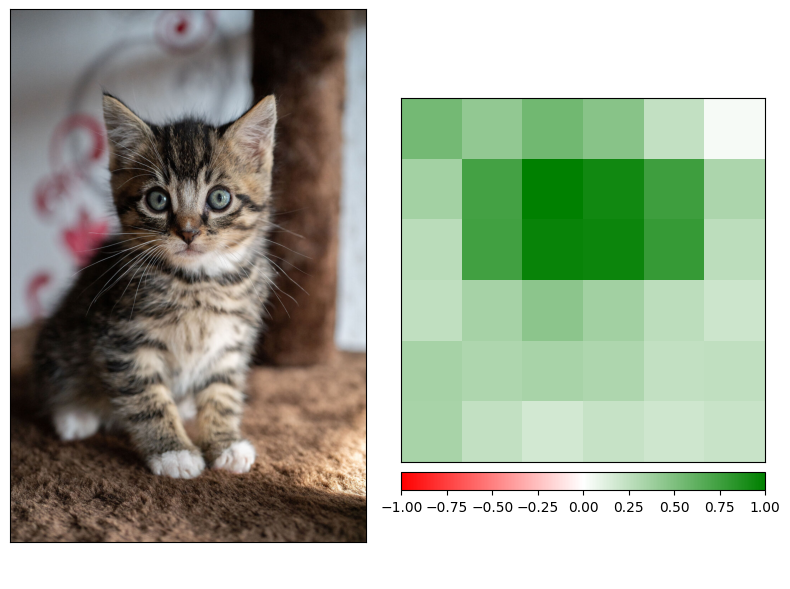

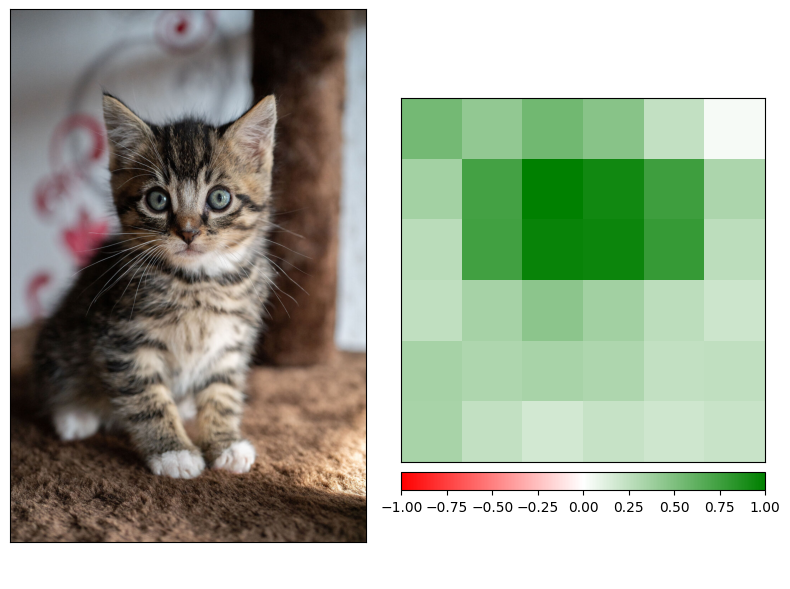

unique (norm->poster): tensor([0.1357, 0.2090, 0.2368, 0.2460, 0.2612, 0.2742, 0.3244, 0.3488, 0.3561,
        0.3921, 0.4701, 0.5634, 0.7585, 0.8733, 0.9859])


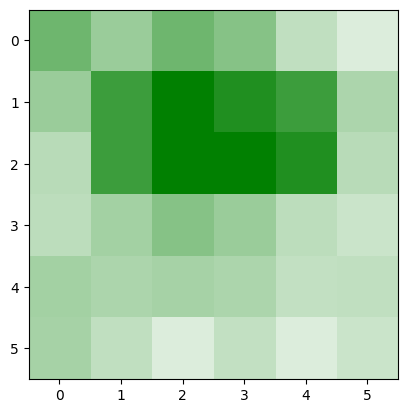

In [31]:
## Playground: Inspect the GradCAM outputs
weights = models.AlexNet_Weights.DEFAULT
model: torch.nn.Module = models.alexnet(weights=weights).eval()
data_preproc = weights.transforms() ## model-specific data preprocessing function
categories = weights.meta["categories"] ## names of output classes; here: ImageNet classes
my_model = my_model_from(model)

preproc_img: TVTensor = data_preproc(img).unsqueeze(0)
prediction = my_model(preproc_img)

gradcam_layer = model.features[-1] ## Adjust to the correct layer in the model
gradcam_explainer = LayerGradCam(model, gradcam_layer)
my_gradcam_explainer = my_explainer_from(gradcam_explainer)

gradcam_explanation = gradcam_explainer.attribute(preproc_img, target=predicted_class_id).squeeze(0)
_ = viz.visualize_image_attr_multiple(to_plottable(gradcam_explanation),
                                      to_plottable(img),
                                      ["original_image", "heat_map"],
                                      ["all", "all"],
                                      show_colorbar=True,
                                      outlier_perc=2)

## Now have a look at the posterized GradCAM outputs:
## first posterize, then normalize
gradcam_explanation_posterized = posterize(gradcam_explanation)
_ = viz.visualize_image_attr_multiple(to_plottable(gradcam_explanation_posterized),
                                      to_plottable(img),
                                      ["original_image", "heat_map"],
                                      ["all", "all"],
                                      show_colorbar=True,
                                      outlier_perc=2)
## first normalize, then posterize:
pp_gradcam_explanation_posterized = posterize(to_normalized_attr(gradcam_explanation), steps=15)
print("unique (norm->poster):", pp_gradcam_explanation_posterized.unique())
plot_attr(pp_gradcam_explanation_posterized)
plt.show()

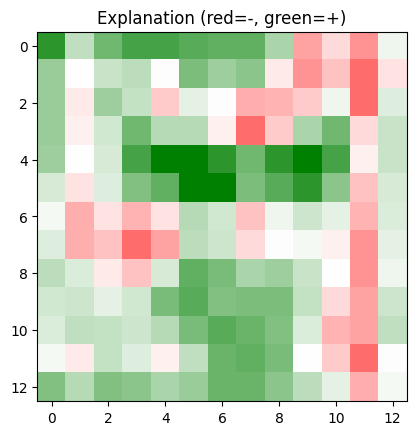

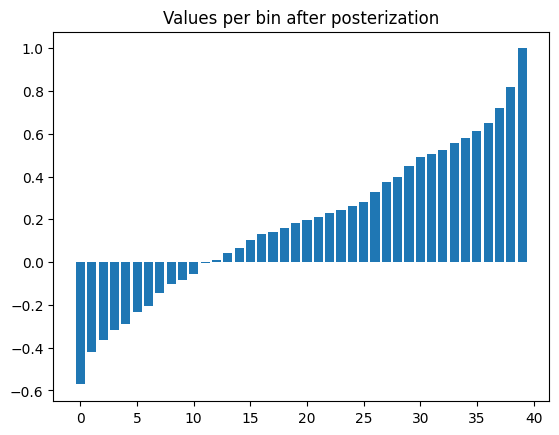

RuntimeError: The size of tensor a (224) must match the size of tensor b (13) at non-singleton dimension 3

In [32]:
## COLLECT the results for a given image using GradCAM
## GradCAM, AlexNet on ImageNet

## Model & explainer
weights = models.AlexNet_Weights.DEFAULT
model: torch.nn.Module = models.alexnet(weights=weights).eval()
data_preproc = weights.transforms() ## model-specific data preprocessing function
categories = weights.meta["categories"] ## names of output classes; here: ImageNet classes
my_model = my_model_from(model)
gradcam_layer = model.features[10] ## Adjust to the correct layer in your model
gradcam_explainer = LayerGradCam(model, gradcam_layer)
my_gradcam_explainer = my_explainer_from(gradcam_explainer)

## Get image
img: TVTensor = tv.io.read_image("kitten.jpg")
preproc_img: TVTensor = data_preproc(img).unsqueeze(0)

## Get results
results_gradcam = collect_class_predictions_under_masking(preproc_img, my_model=my_model, my_explainer=my_gradcam_explainer, plot=True)

## Evaluate the results
metric = torcheval.metrics.AUC()
metric.update(torch.tensor(results_gradcam["nums_features_removed"]), torch.tensor(results_gradcam["class_predictions"]))
auc_gradcam = metric.compute().item()
print("GradCAM AUC: ", auc_gradcam)

## Show the plot how the class probability decreases with increasing masking steps
plt.title(f"GradCAM AUC: {auc_gradcam:.5}")
plt.plot(results_gradcam["nums_features_removed"], results_gradcam["class_predictions"])
print("Predicted labels after each step: ", results_gradcam["best_classes"]) ## when did the cat cease to be cat-like?